# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [25]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [7]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels, num_classes = n_classes)
    #### END CODE HERE ####

In [8]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [29]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [30]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [15]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [17]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Extracting .\MNIST\raw\train-images-idx3-ubyte.gz to .\MNIST\raw


Extracting .\MNIST\raw\train-labels-idx1-ubyte.gz to .\MNIST\raw



Extracting .\MNIST\raw\t10k-images-idx3-ubyte.gz to .\MNIST\raw


Extracting .\MNIST\raw\t10k-labels-idx1-ubyte.gz to .\MNIST\raw
Processing...


..\torch\csrc\utils\tensor_numpy.cpp:141: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program.


Done!


Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [22]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [23]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [26]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 1.977574043750763, discriminator loss: 0.3454391232430935


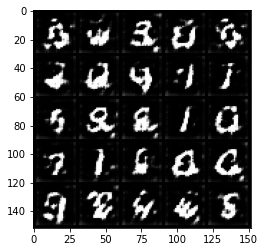

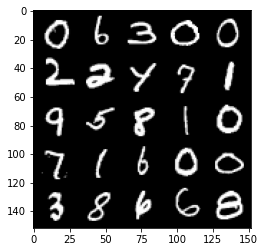

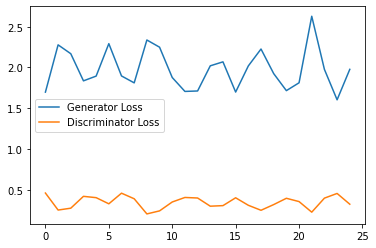

Step 1000: Generator loss: 1.9065841269493102, discriminator loss: 0.3547720657289028


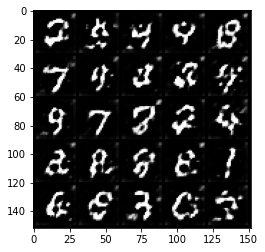

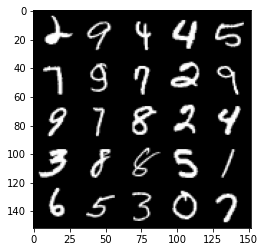

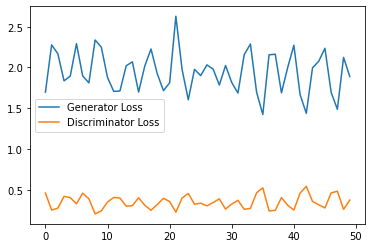

Step 1500: Generator loss: 1.999803261756897, discriminator loss: 0.36295683535933493


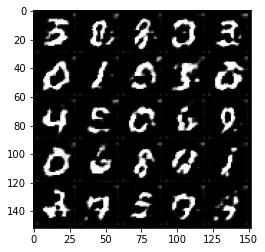

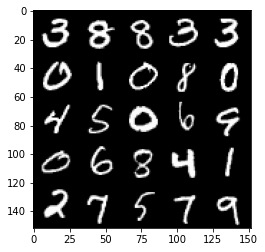

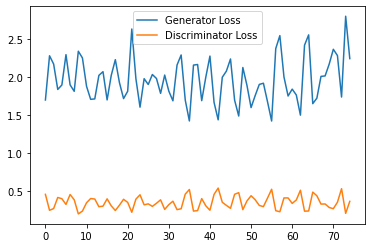

Step 2000: Generator loss: 1.7876086230278014, discriminator loss: 0.380337376922369


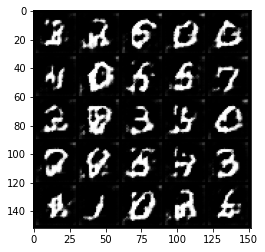

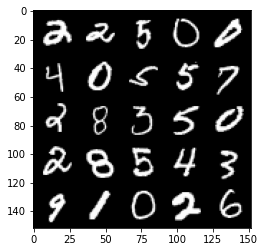

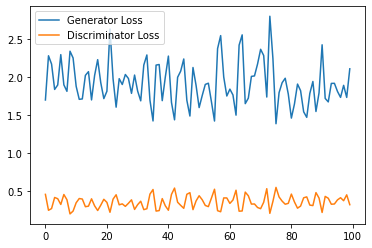

Step 2500: Generator loss: 1.766552077293396, discriminator loss: 0.3671369886398315


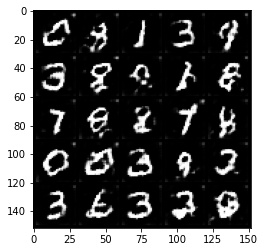

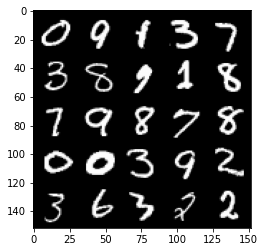

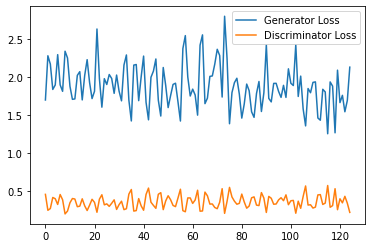

Step 3000: Generator loss: 1.6835173511505126, discriminator loss: 0.3930230897963047


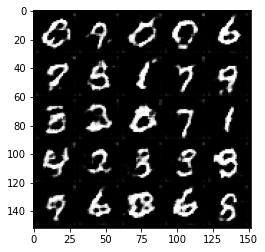

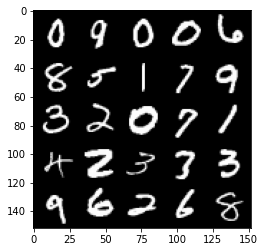

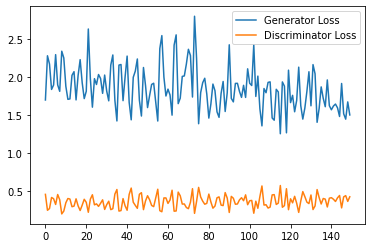

Step 3500: Generator loss: 1.6883621563911437, discriminator loss: 0.4052649177312851


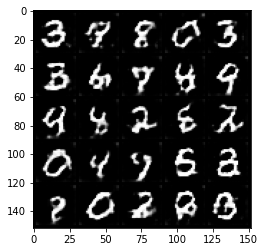

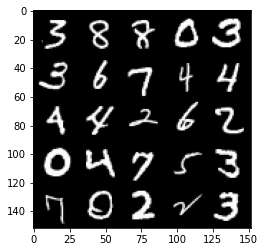

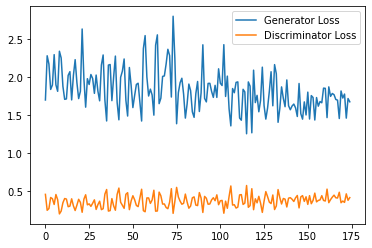

Step 4000: Generator loss: 1.5422323524951935, discriminator loss: 0.4459897077083588


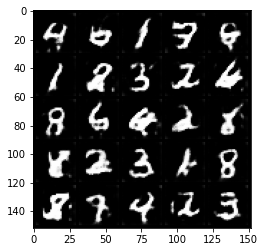

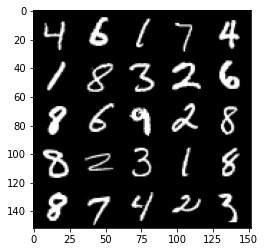

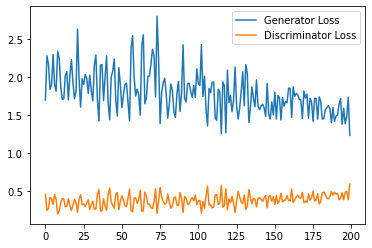

Step 4500: Generator loss: 1.4982912234067918, discriminator loss: 0.4567477785944939


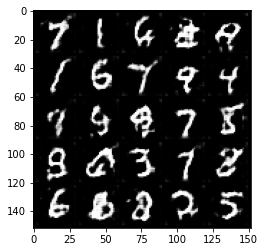

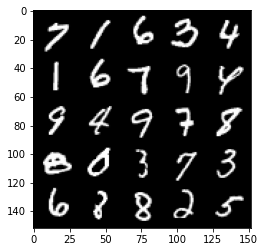

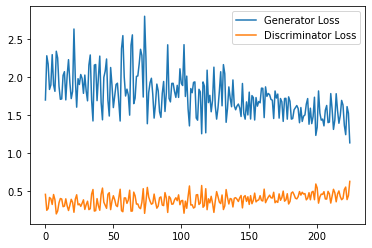

Step 5000: Generator loss: 1.3444610903263092, discriminator loss: 0.47270610970258714


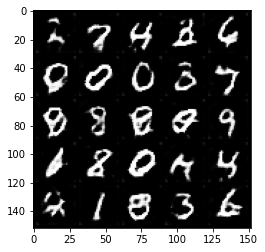

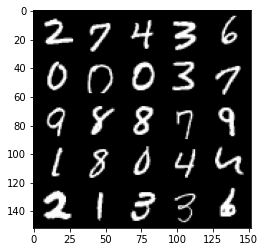

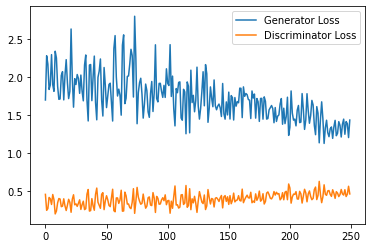

Step 5500: Generator loss: 1.3809725124835968, discriminator loss: 0.4957193663716316


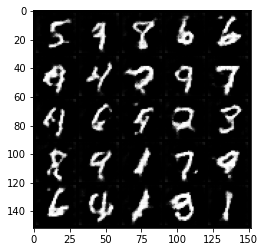

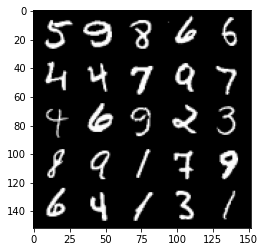

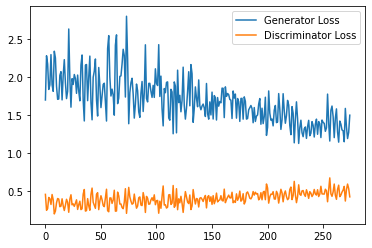

Step 6000: Generator loss: 1.3572337943315507, discriminator loss: 0.5147029124498367


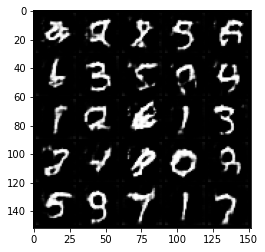

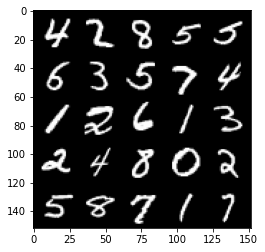

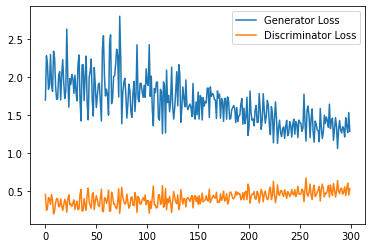

Step 6500: Generator loss: 1.2926177874803544, discriminator loss: 0.5148172889947891


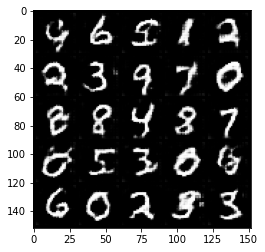

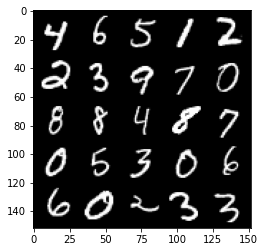

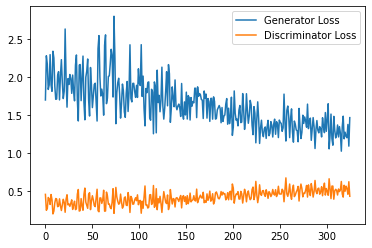

Step 7000: Generator loss: 1.3609452270269393, discriminator loss: 0.5283530557155609


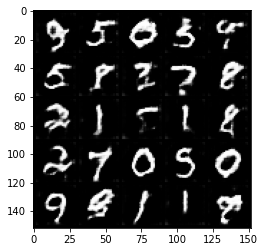

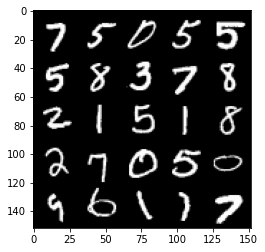

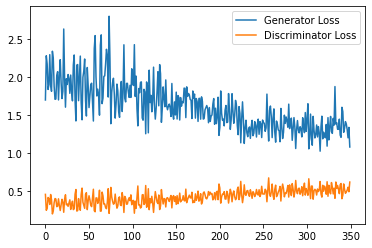

Step 7500: Generator loss: 1.1959729592800141, discriminator loss: 0.5278915214538574


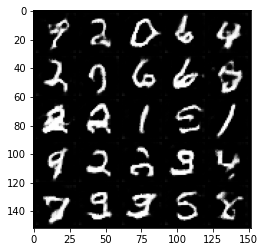

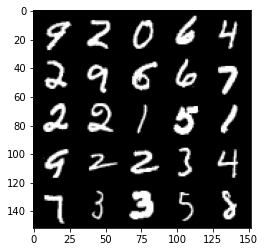

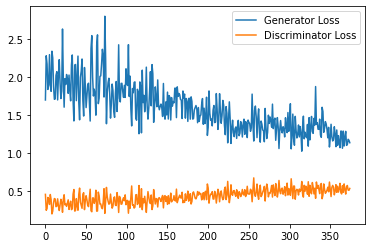

Step 8000: Generator loss: 1.1963452748060226, discriminator loss: 0.5341853571534156


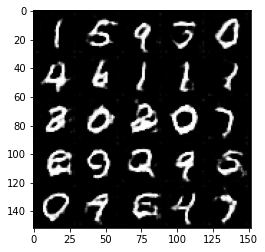

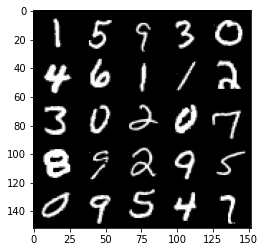

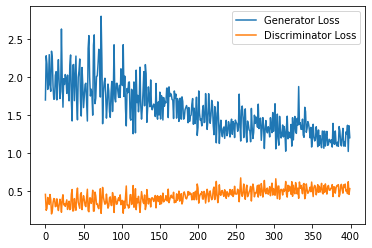

Step 8500: Generator loss: 1.2400445853471755, discriminator loss: 0.5425913586616516


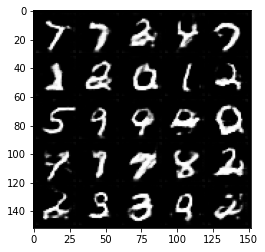

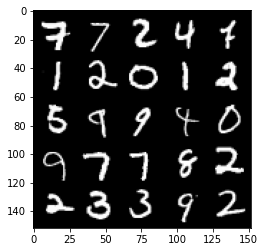

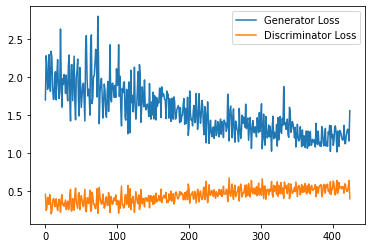

Step 9000: Generator loss: 1.1837444614171981, discriminator loss: 0.5486624519228935


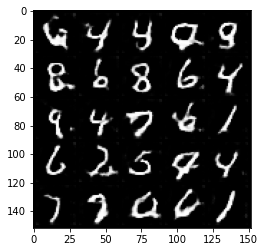

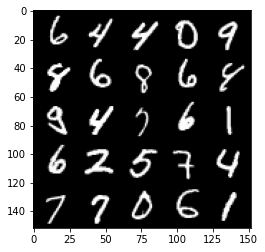

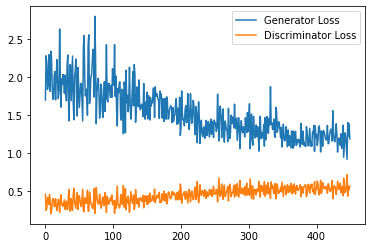

Step 9500: Generator loss: 1.1311725701093673, discriminator loss: 0.5583375148177147


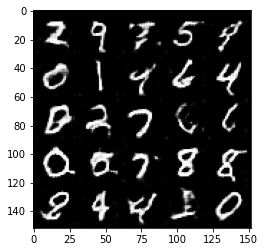

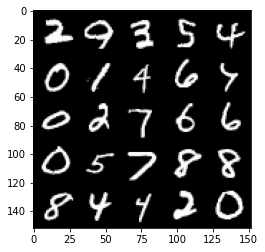

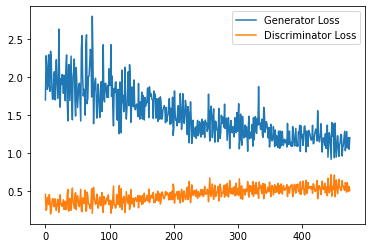

Step 10000: Generator loss: 1.1274380915164948, discriminator loss: 0.5684490553736686


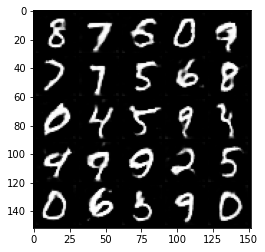

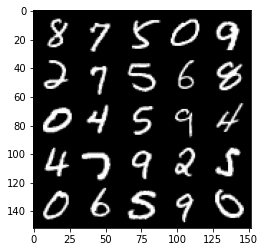

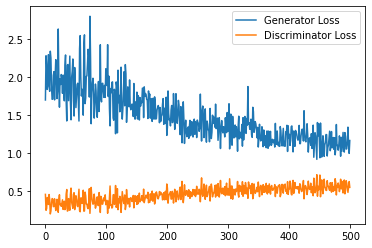

Step 10500: Generator loss: 1.1526988551616668, discriminator loss: 0.5683025963306427


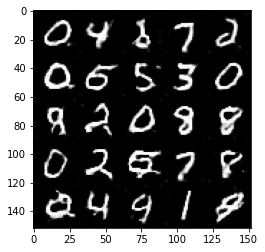

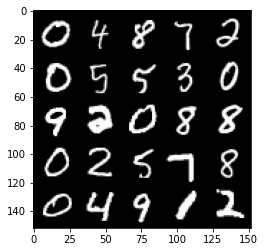

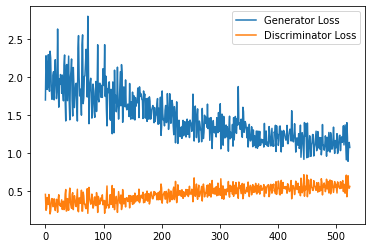

Step 11000: Generator loss: 1.0998200951814652, discriminator loss: 0.5719031657576561


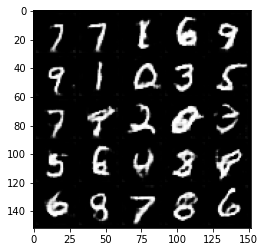

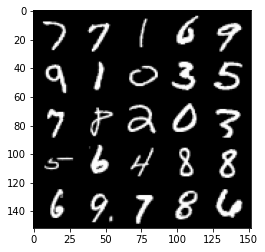

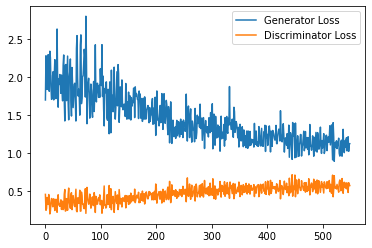

Step 11500: Generator loss: 1.0947676964998245, discriminator loss: 0.565195599257946


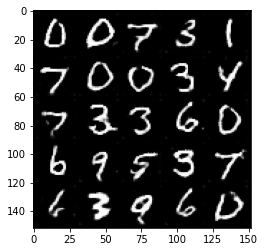

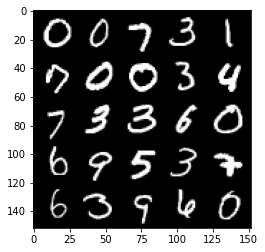

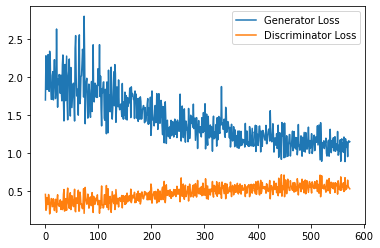

Step 12000: Generator loss: 1.1097759631872177, discriminator loss: 0.5890928738713265


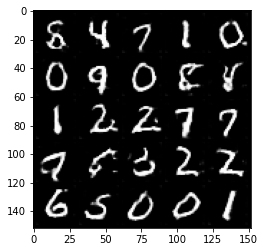

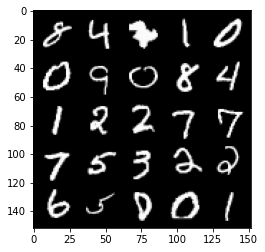

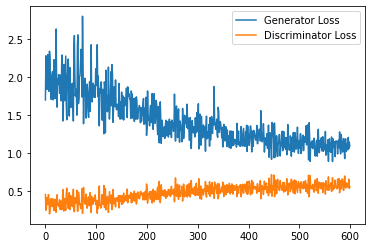

Step 12500: Generator loss: 1.0544671359062194, discriminator loss: 0.5830459417700767


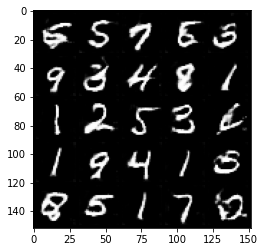

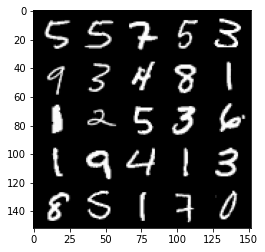

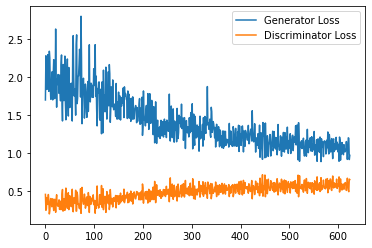

Step 13000: Generator loss: 1.0920079694986344, discriminator loss: 0.5784245346188546


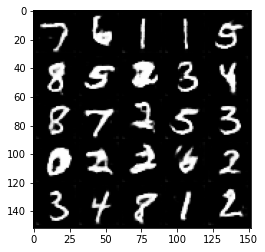

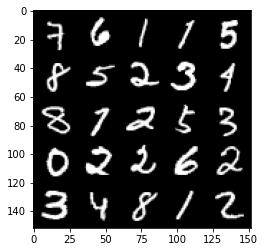

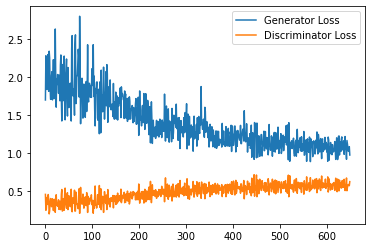

Step 13500: Generator loss: 1.0634597963094712, discriminator loss: 0.5777858796715737


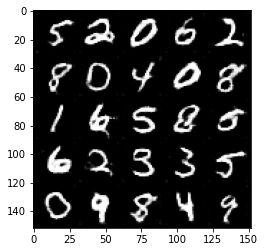

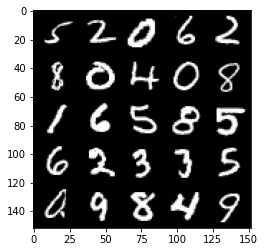

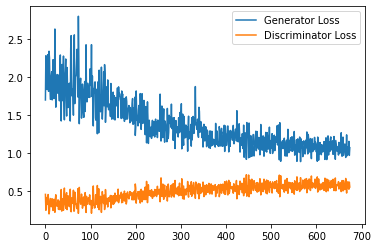

Step 14000: Generator loss: 1.066069795370102, discriminator loss: 0.5877459350824356


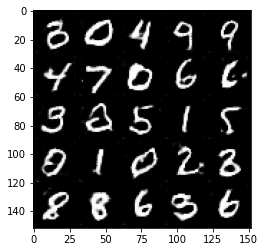

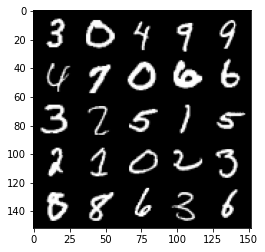

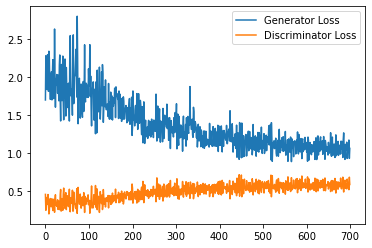

Step 14500: Generator loss: 1.0651093508005143, discriminator loss: 0.5882293205261231


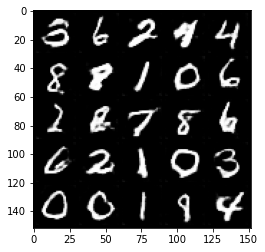

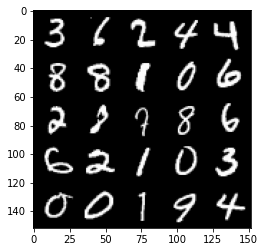

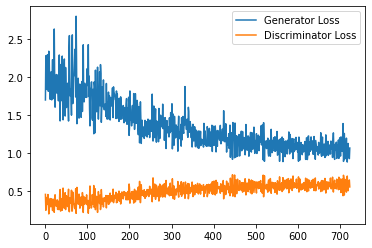

Step 15000: Generator loss: 1.0120417795181273, discriminator loss: 0.590981175661087


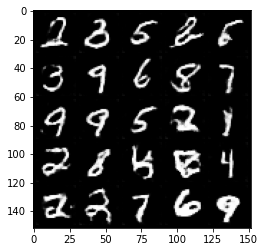

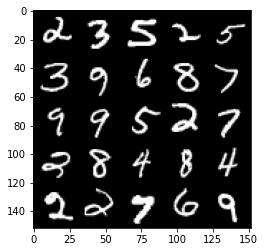

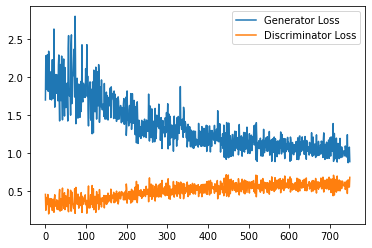

Step 15500: Generator loss: 1.034872552752495, discriminator loss: 0.5906354635357857


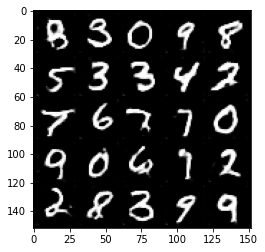

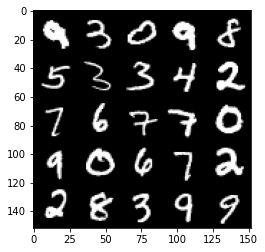

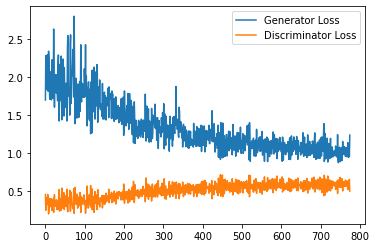

Step 16000: Generator loss: 1.0256829044818878, discriminator loss: 0.6003456939458847


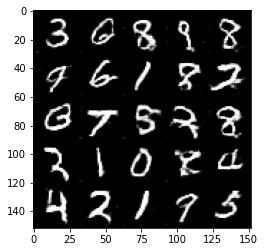

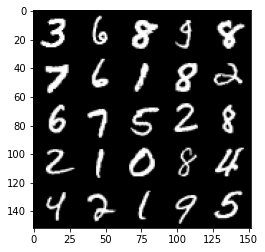

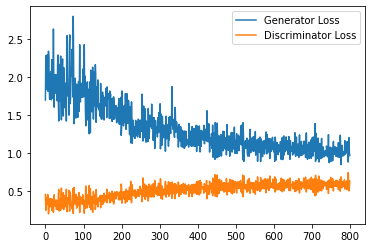

Step 16500: Generator loss: 1.0432637351751328, discriminator loss: 0.6051489527225494


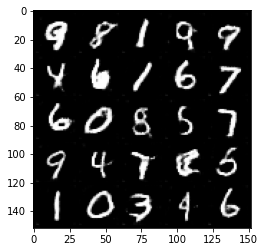

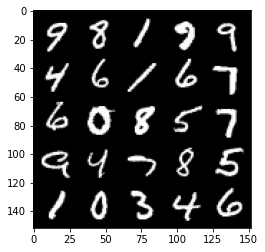

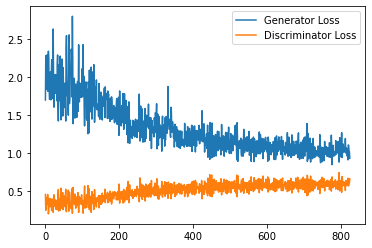

Step 17000: Generator loss: 0.9931731253862381, discriminator loss: 0.5947673751115798


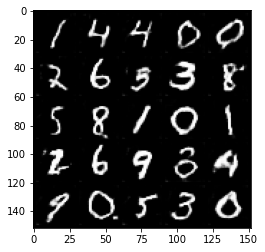

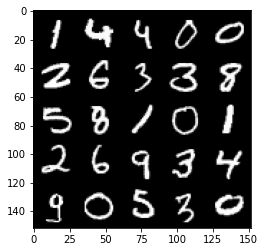

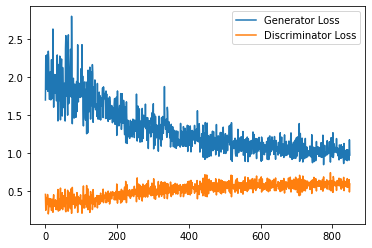

Step 17500: Generator loss: 1.0389259479045867, discriminator loss: 0.6022174607515335


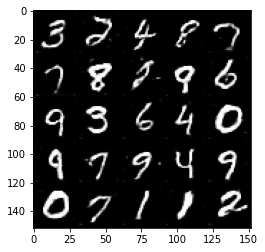

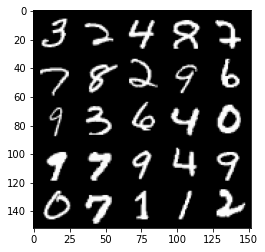

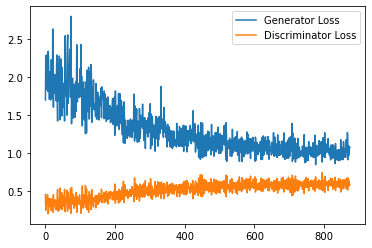

Step 18000: Generator loss: 1.0117894926071167, discriminator loss: 0.6052858802676201


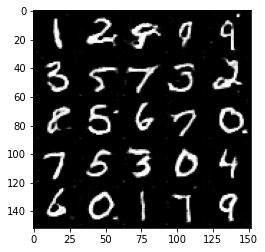

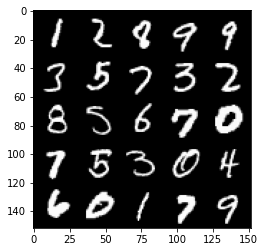

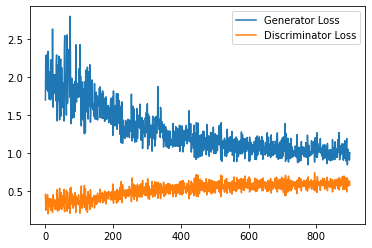

Step 18500: Generator loss: 0.9781289758682251, discriminator loss: 0.608879174888134


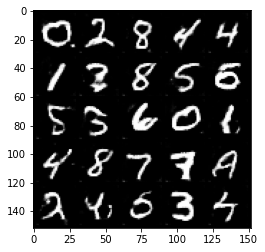

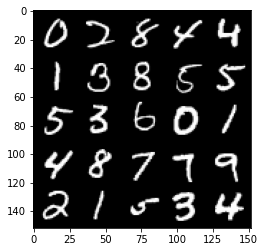

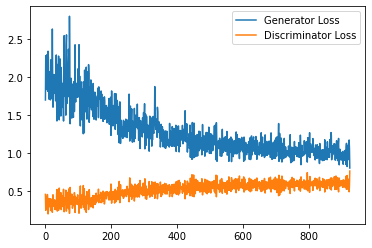

Step 19000: Generator loss: 1.0077103056907655, discriminator loss: 0.599365919649601


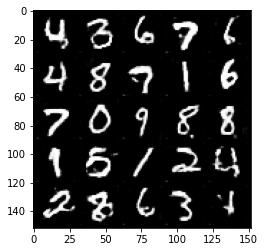

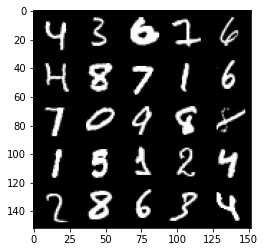

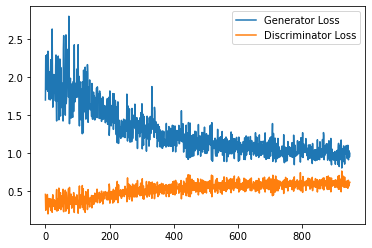

Step 19500: Generator loss: 0.9658647577762604, discriminator loss: 0.6013268339633941


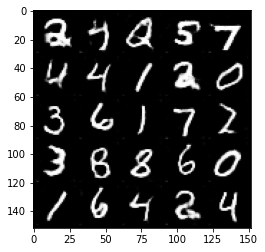

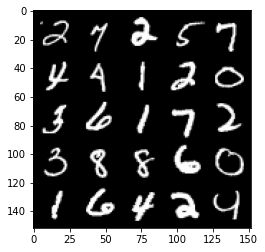

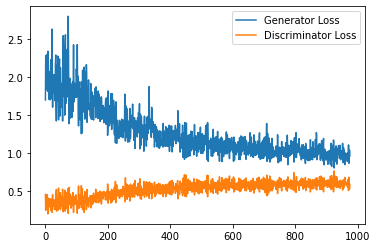

Step 20000: Generator loss: 0.9973893563747406, discriminator loss: 0.6068631663918496


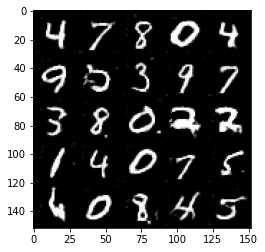

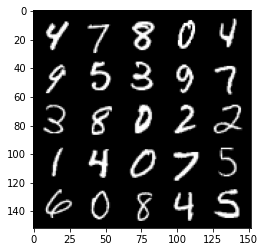

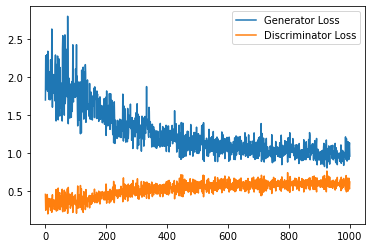

Step 20500: Generator loss: 0.9981629014015198, discriminator loss: 0.6006050838828086


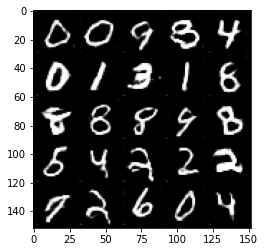

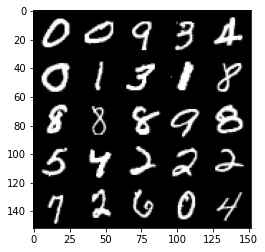

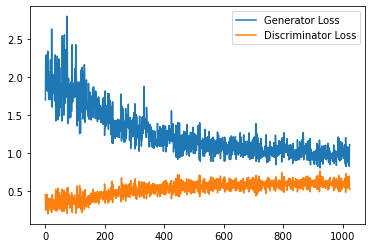

Step 21000: Generator loss: 0.9901838101148606, discriminator loss: 0.6069539491534233


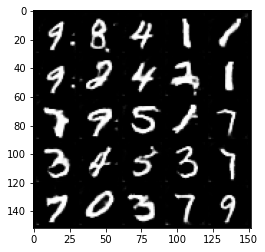

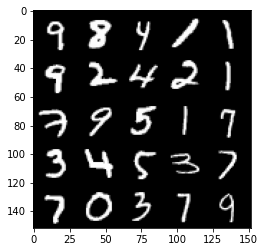

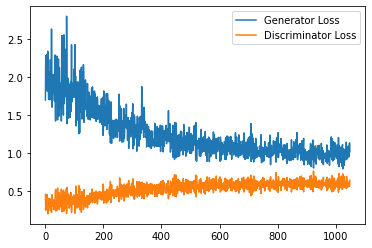

Step 21500: Generator loss: 0.9758649348020554, discriminator loss: 0.6060912084579467


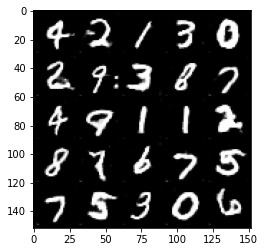

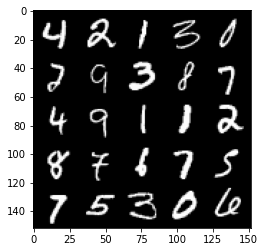

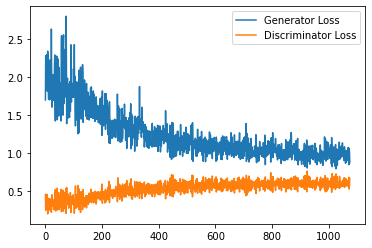

Step 22000: Generator loss: 0.99307703769207, discriminator loss: 0.6000981320142746


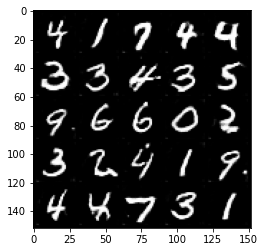

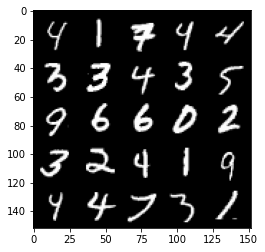

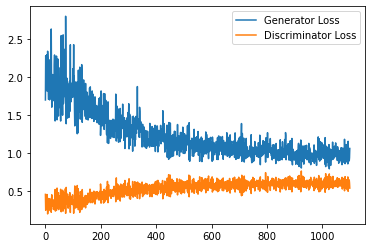

Step 22500: Generator loss: 0.9810989316701889, discriminator loss: 0.6100740112662315


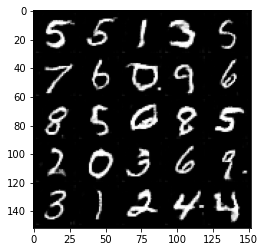

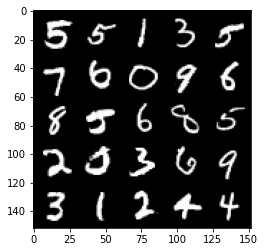

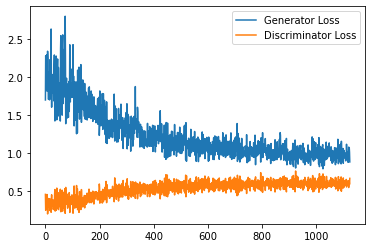

Step 23000: Generator loss: 0.9652243809700012, discriminator loss: 0.6061101542115211


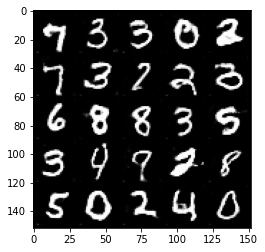

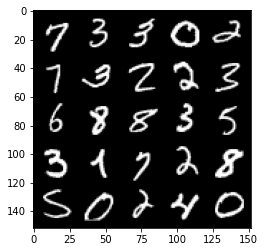

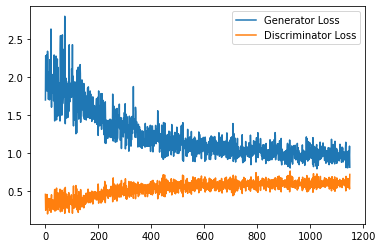

Step 23500: Generator loss: 0.9663385835886001, discriminator loss: 0.6057240836024285


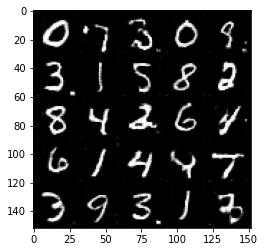

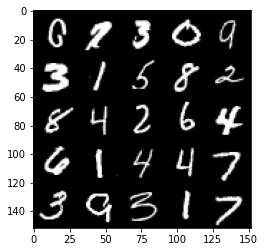

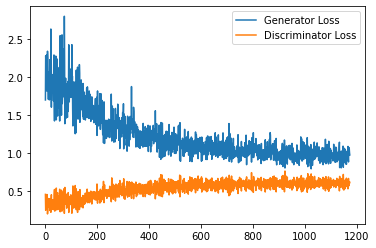

Step 24000: Generator loss: 1.0050642166137695, discriminator loss: 0.6113513650894165


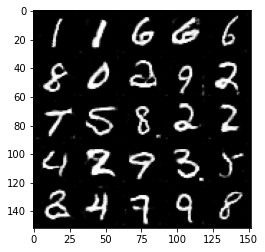

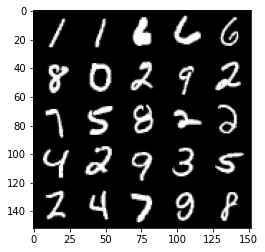

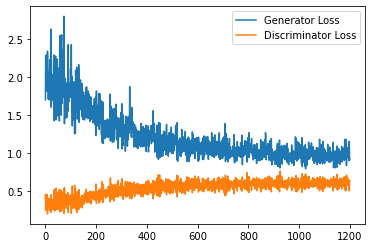

Step 24500: Generator loss: 0.9785813002586364, discriminator loss: 0.6064335322976112


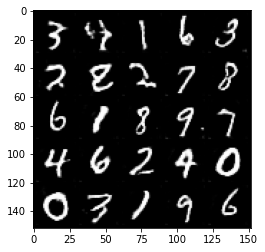

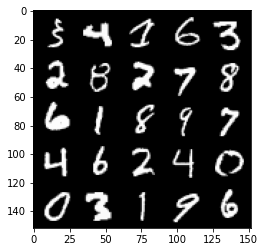

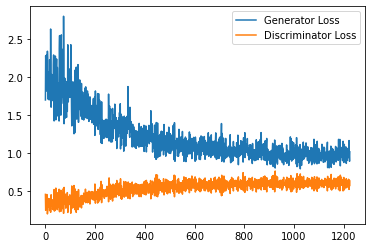

Step 25000: Generator loss: 0.9578662667274475, discriminator loss: 0.6113959101438522


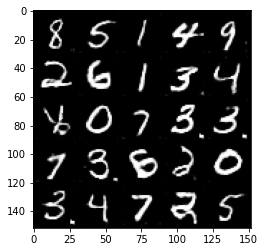

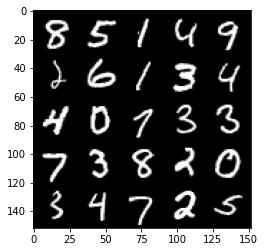

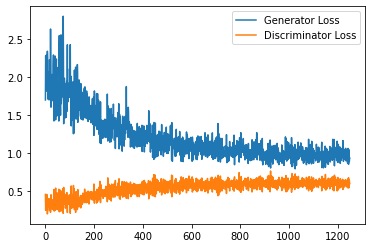

Step 25500: Generator loss: 0.9689749678373337, discriminator loss: 0.6071707855463028


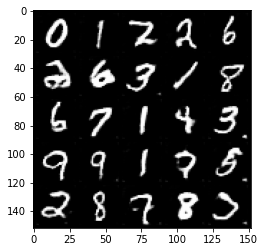

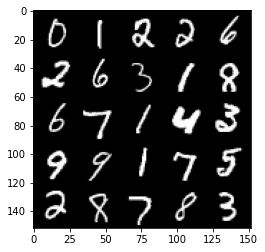

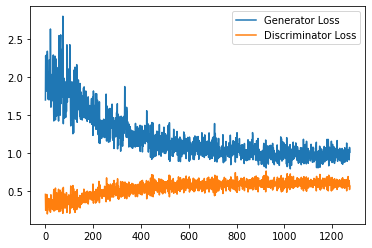

Step 26000: Generator loss: 0.9753914653062821, discriminator loss: 0.6118836445808411


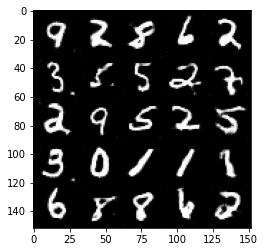

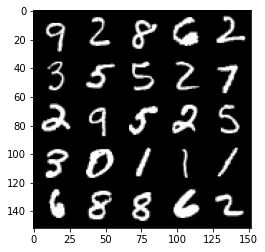

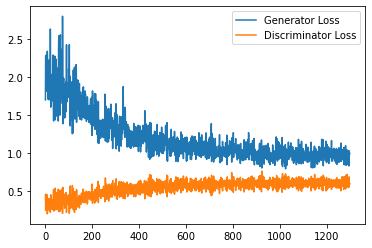

Step 26500: Generator loss: 0.9690081074237823, discriminator loss: 0.6059435054659843


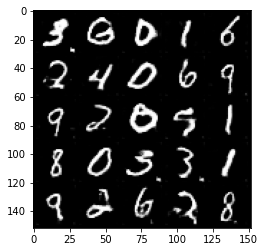

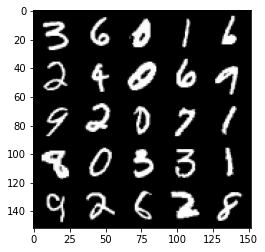

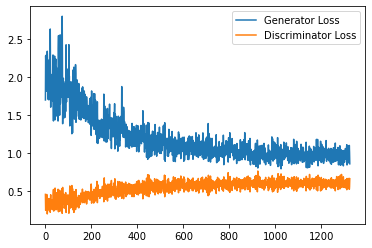

Step 27000: Generator loss: 0.9761436600685119, discriminator loss: 0.6097050745487214


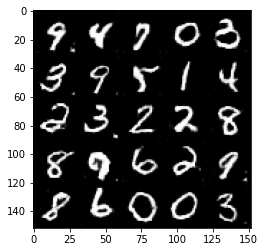

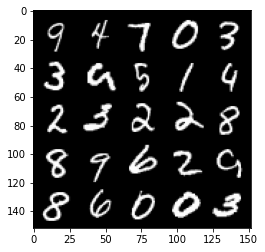

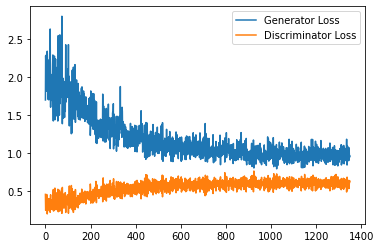

Step 27500: Generator loss: 0.9667807894945145, discriminator loss: 0.6053063793182373


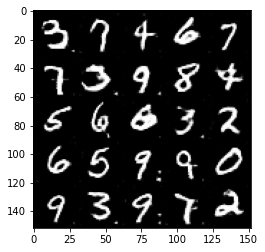

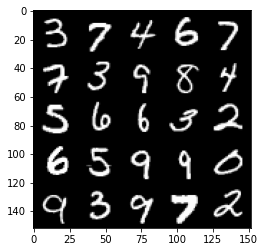

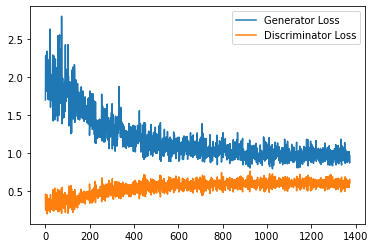

Step 28000: Generator loss: 0.9597295233011246, discriminator loss: 0.6086163948774338


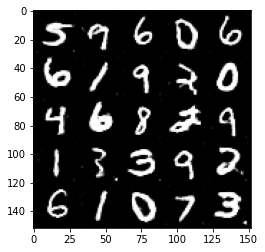

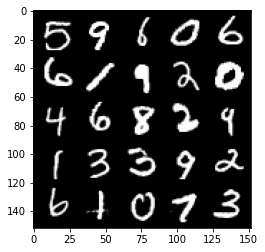

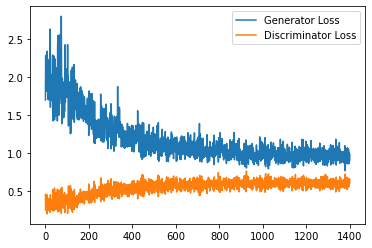

Step 28500: Generator loss: 0.9641482357978821, discriminator loss: 0.6056013643145561


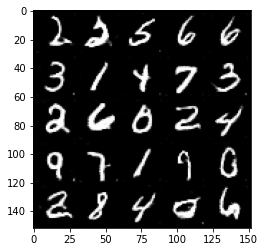

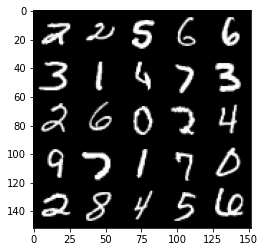

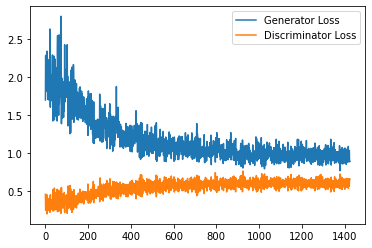

Step 29000: Generator loss: 0.9932939585447311, discriminator loss: 0.6003399017453194


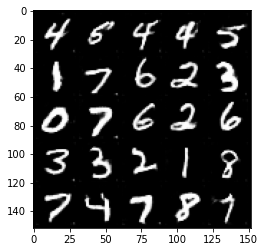

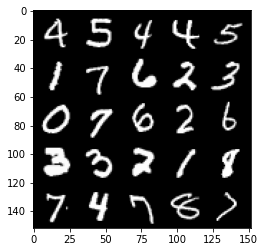

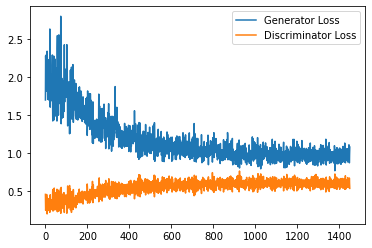

Step 29500: Generator loss: 0.9615842940807342, discriminator loss: 0.6065487523674965


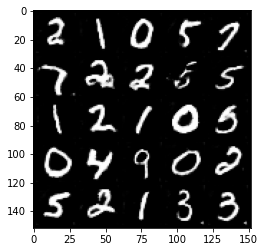

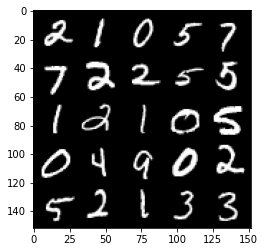

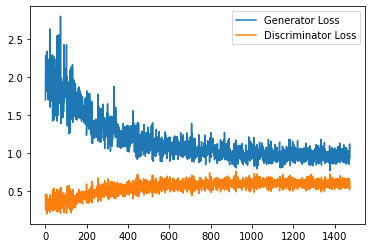

Step 30000: Generator loss: 0.9505922958850861, discriminator loss: 0.6067478566169738


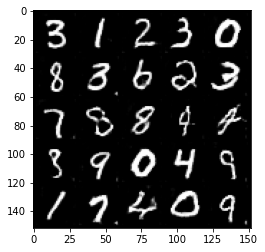

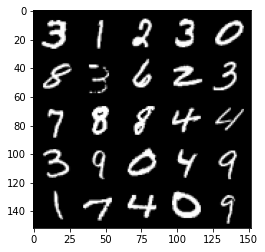

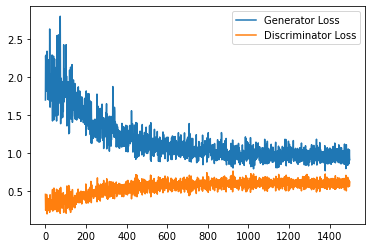

Step 30500: Generator loss: 0.9729388413429261, discriminator loss: 0.608716721534729


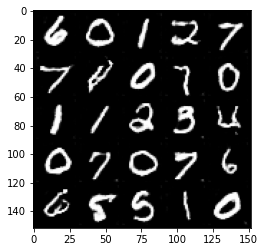

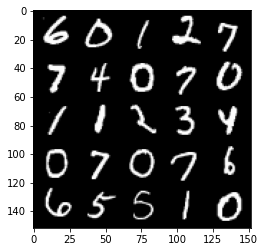

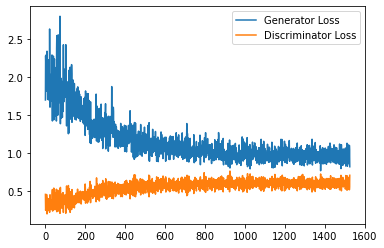

Step 31000: Generator loss: 0.9636097295284272, discriminator loss: 0.6061043944358826


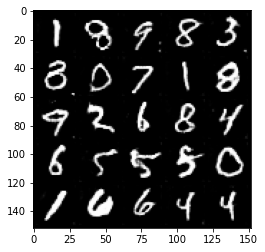

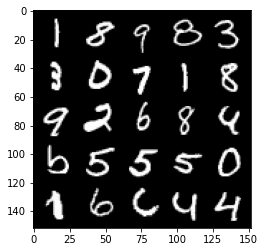

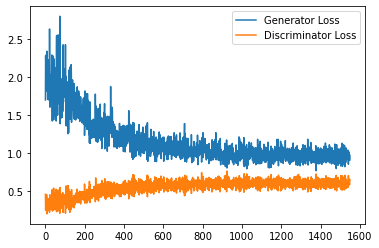

Step 31500: Generator loss: 0.9726176865100861, discriminator loss: 0.6131789979934692


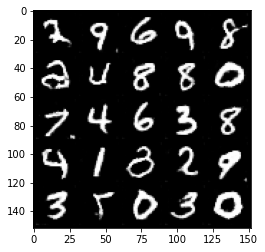

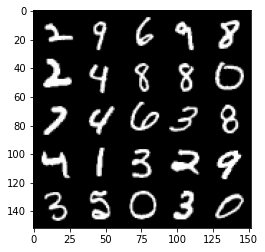

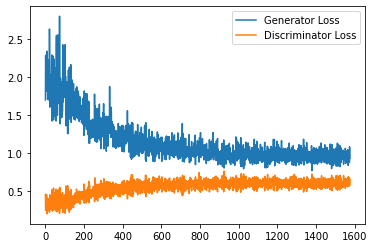

Step 32000: Generator loss: 0.9944878088235856, discriminator loss: 0.6038473073840142


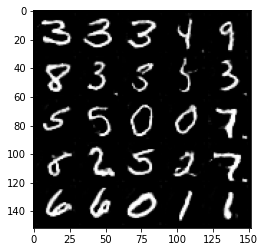

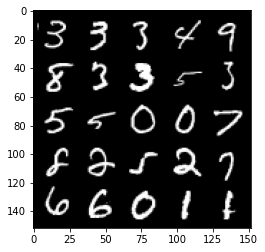

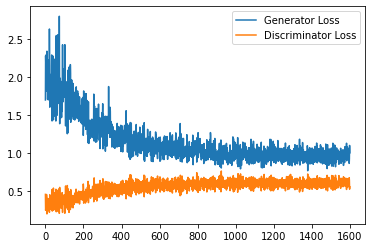

Step 32500: Generator loss: 0.9614605244398117, discriminator loss: 0.6085612543821335


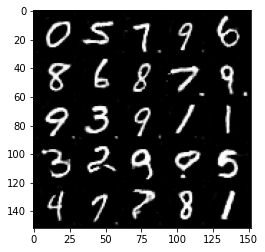

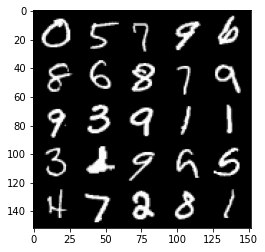

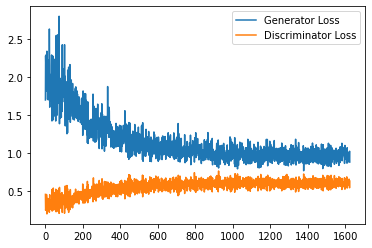

Step 33000: Generator loss: 0.970642984867096, discriminator loss: 0.6060451925396919


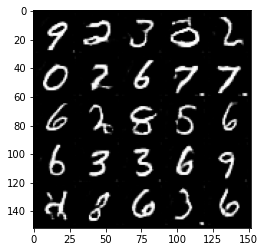

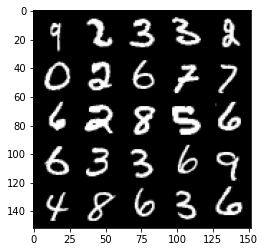

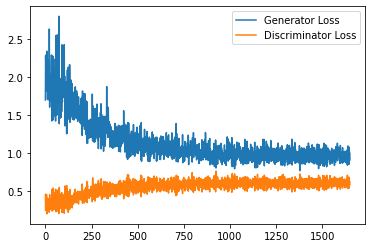

Step 33500: Generator loss: 0.9649749225378037, discriminator loss: 0.6090874102115631


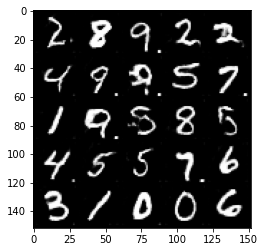

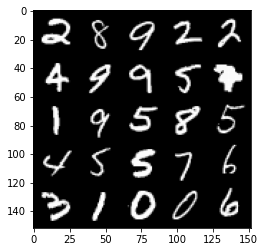

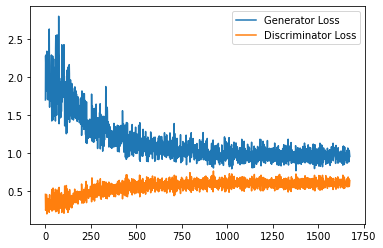

Step 34000: Generator loss: 0.9795331108570099, discriminator loss: 0.605683510005474


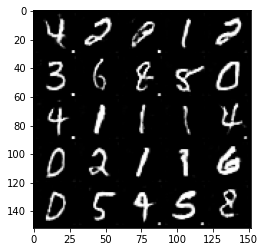

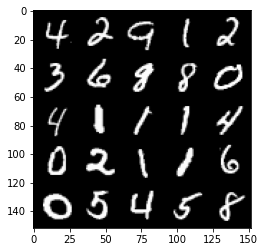

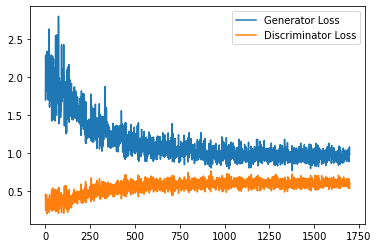

Step 34500: Generator loss: 0.9748538209199905, discriminator loss: 0.6017043967247009


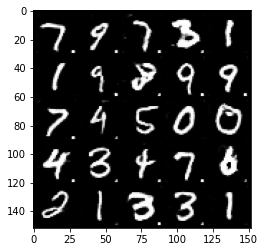

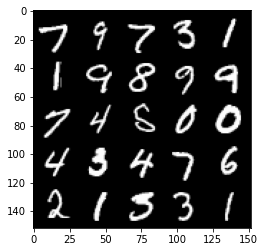

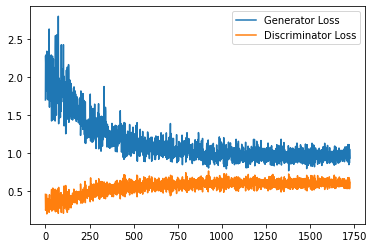

Step 35000: Generator loss: 0.9680592982769013, discriminator loss: 0.6060478186011314


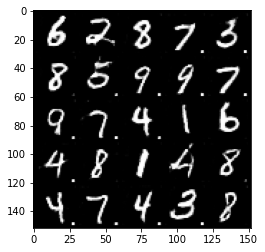

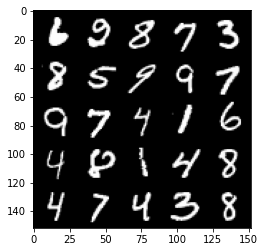

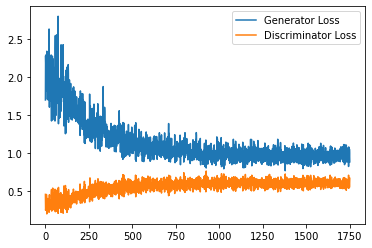

Step 35500: Generator loss: 0.9913709760904312, discriminator loss: 0.6050499022006989


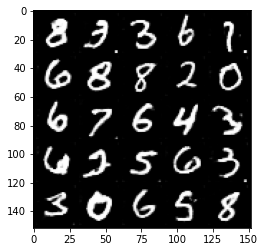

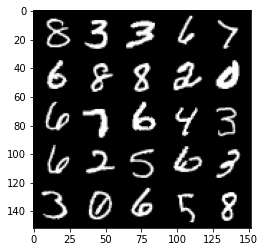

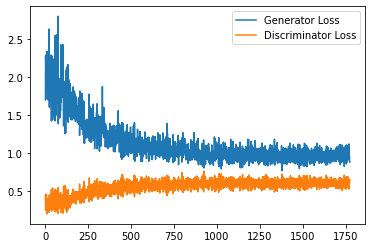

Step 36000: Generator loss: 0.9659076875448227, discriminator loss: 0.6075597039461136


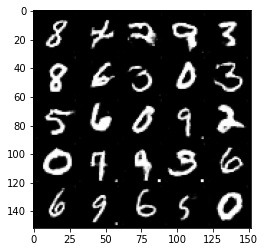

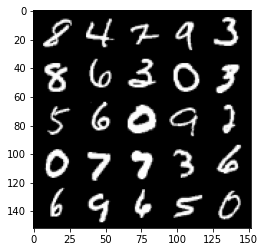

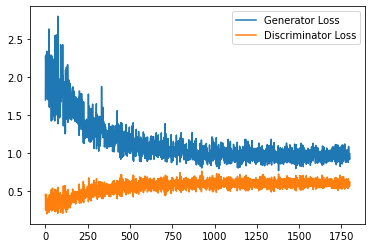

Step 36500: Generator loss: 0.9543911296129227, discriminator loss: 0.6061704485416413


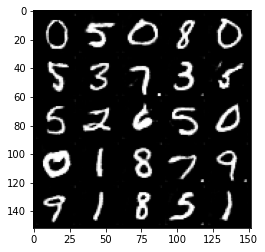

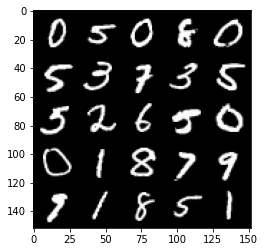

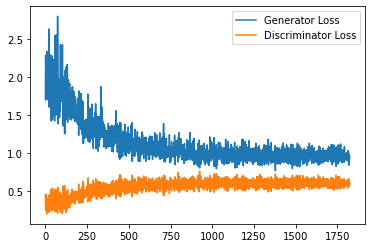

Step 37000: Generator loss: 0.9764156552553177, discriminator loss: 0.6109164970517158


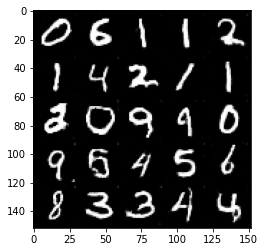

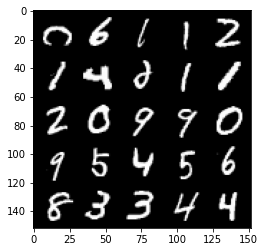

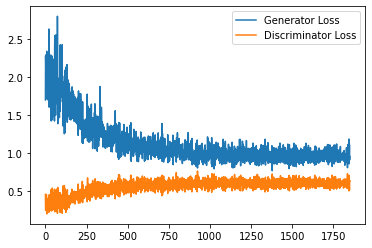

Step 37500: Generator loss: 0.9660802356004715, discriminator loss: 0.6084559786319733


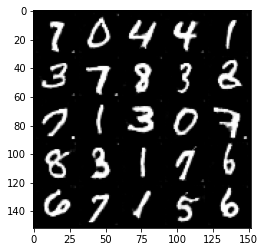

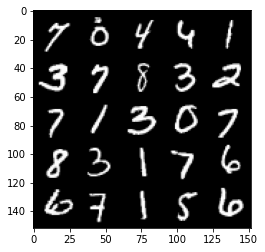

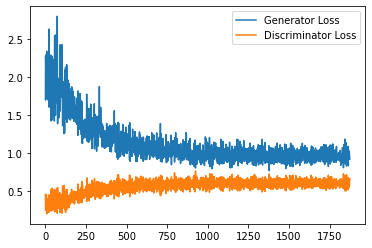

Step 38000: Generator loss: 0.9612474668025971, discriminator loss: 0.6035473345518112


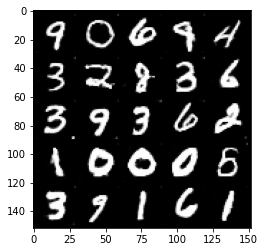

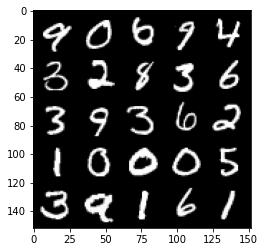

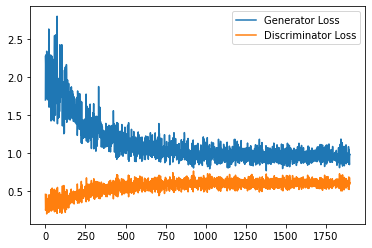

Step 38500: Generator loss: 0.9606557211875916, discriminator loss: 0.6065191265344619


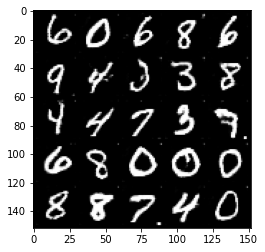

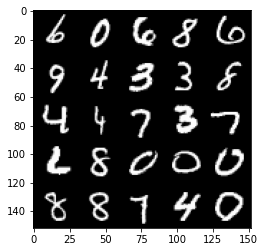

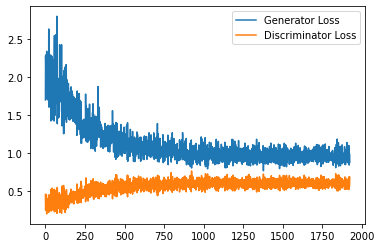

Step 39000: Generator loss: 0.9899918880462647, discriminator loss: 0.6061744087934494


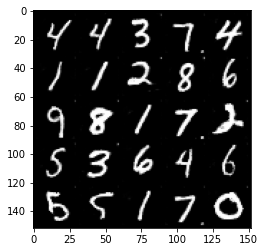

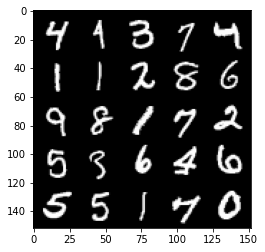

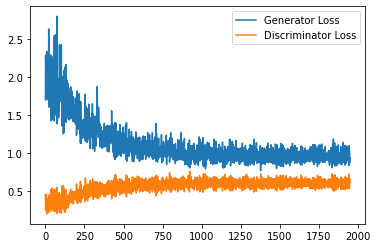

Step 39500: Generator loss: 0.9744212819337845, discriminator loss: 0.602610650062561


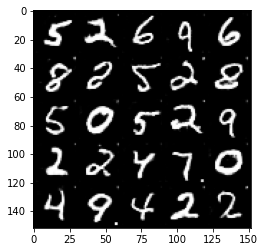

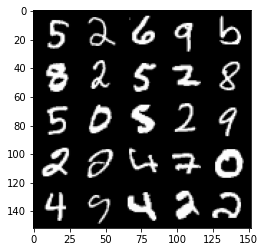

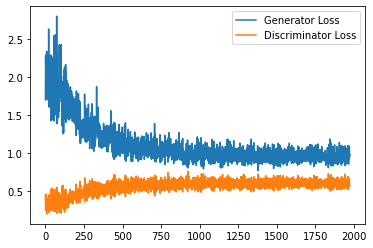

Step 40000: Generator loss: 0.9386067707538605, discriminator loss: 0.6114036303162574


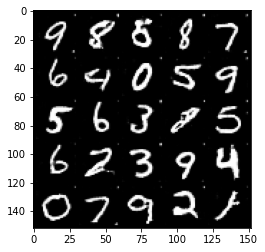

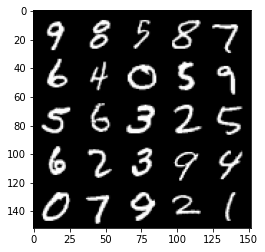

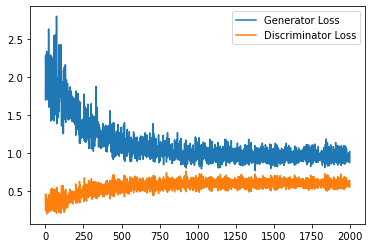

Step 40500: Generator loss: 0.9678424896001816, discriminator loss: 0.6040135124921798


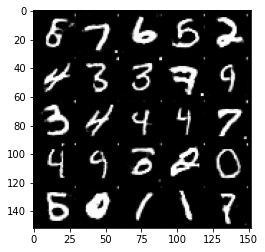

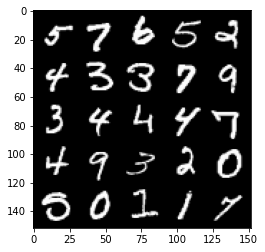

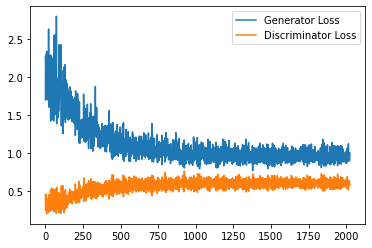

Step 41000: Generator loss: 0.9751686990261078, discriminator loss: 0.6095480115413666


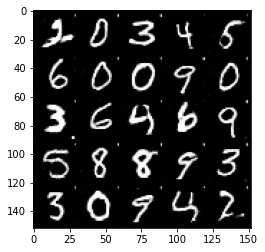

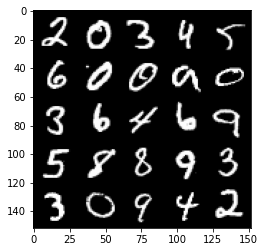

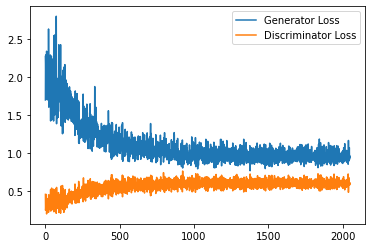

Step 41500: Generator loss: 0.9512184785604477, discriminator loss: 0.6060026958584785


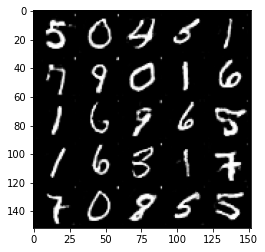

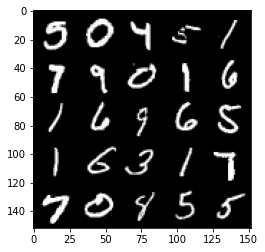

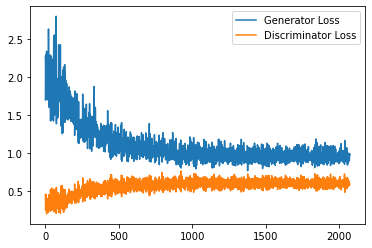

Step 42000: Generator loss: 0.9468589016199112, discriminator loss: 0.609094801723957


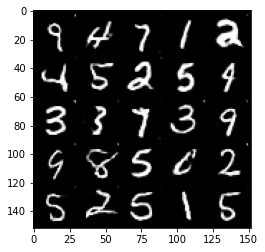

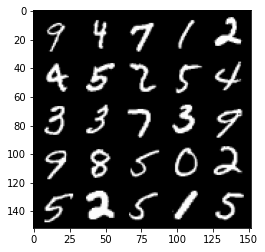

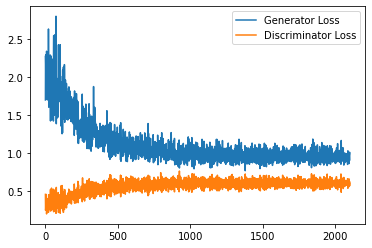

Step 42500: Generator loss: 0.9697564160823822, discriminator loss: 0.6055387788414955


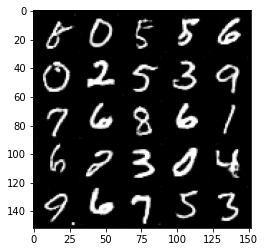

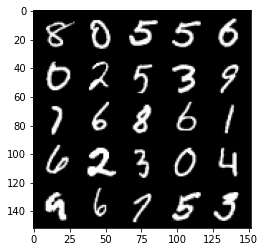

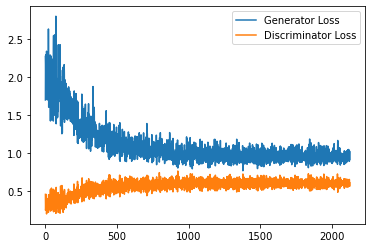

Step 43000: Generator loss: 0.9623117858171463, discriminator loss: 0.6083330040574074


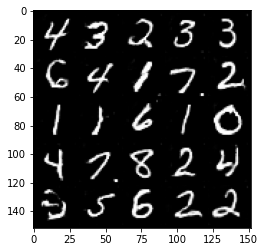

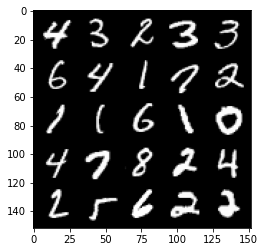

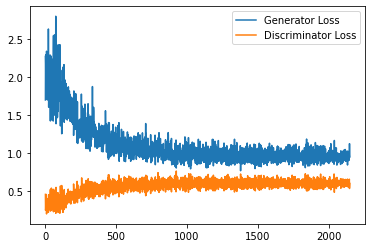

Step 43500: Generator loss: 0.9402480653524399, discriminator loss: 0.6116636627316475


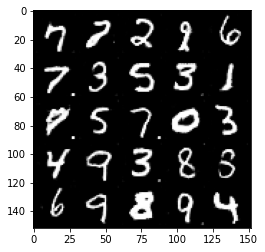

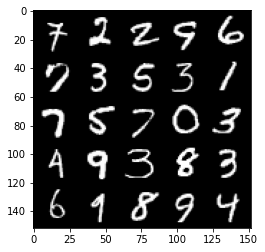

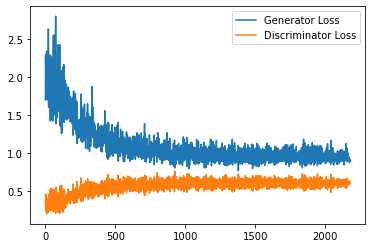

Step 44000: Generator loss: 0.9699532600641251, discriminator loss: 0.605130405664444


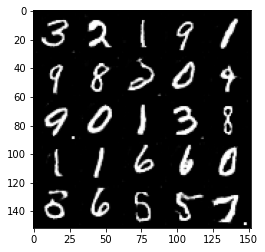

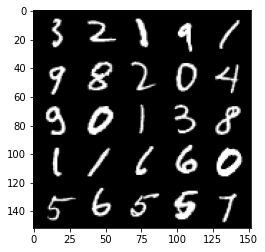

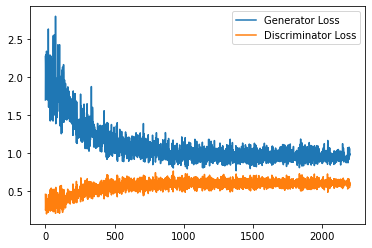

Step 44500: Generator loss: 0.9725665185451507, discriminator loss: 0.6079999807476998


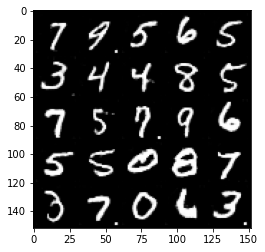

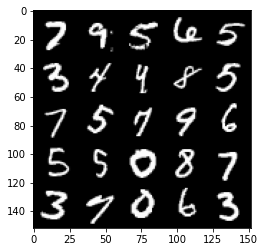

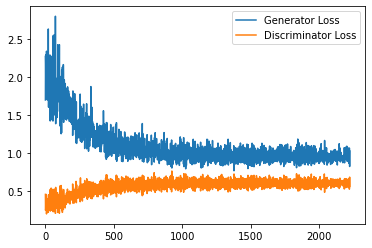

Step 45000: Generator loss: 0.9620918709039689, discriminator loss: 0.6055813364982605


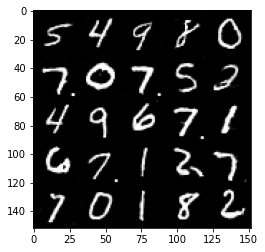

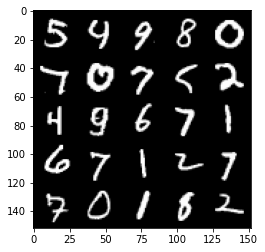

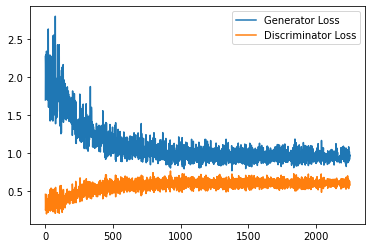

Step 45500: Generator loss: 0.9501197261810302, discriminator loss: 0.6062351177930831


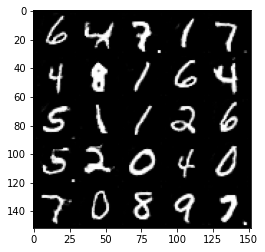

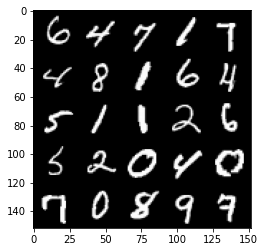

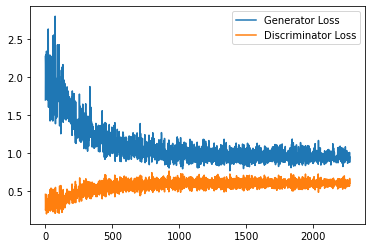

Step 46000: Generator loss: 0.9593811639547348, discriminator loss: 0.6039484071135521


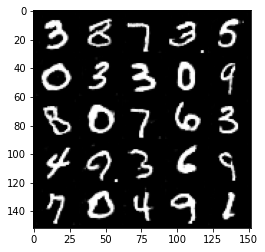

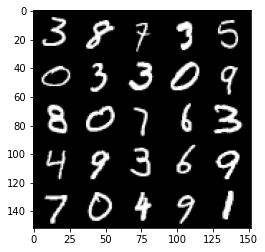

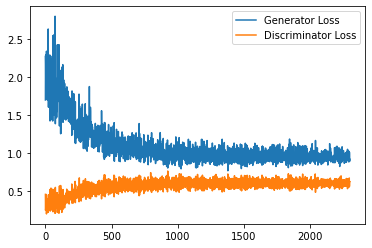

Step 46500: Generator loss: 0.9661580072641373, discriminator loss: 0.6054729099273681


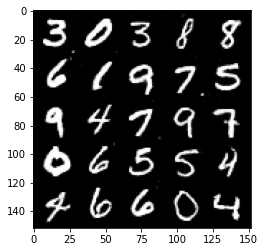

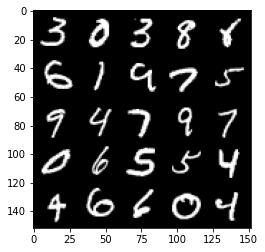

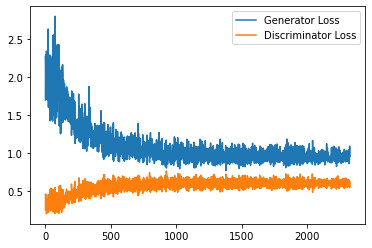

Step 47000: Generator loss: 0.9726017272472381, discriminator loss: 0.6030743854045868


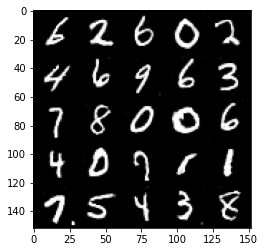

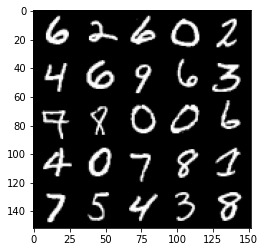

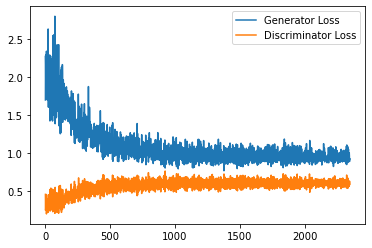

Step 47500: Generator loss: 0.9570970314741135, discriminator loss: 0.6054986534118653


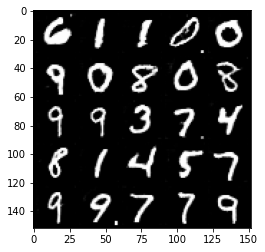

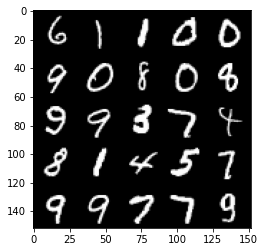

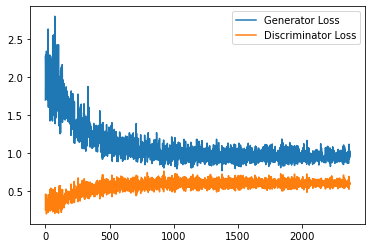

Step 48000: Generator loss: 0.9644148627519608, discriminator loss: 0.6062029638886451


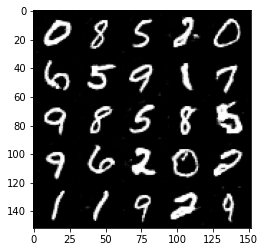

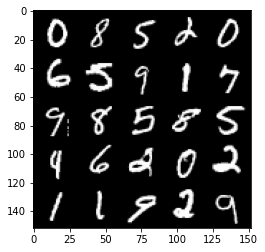

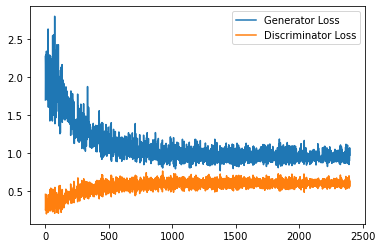

Step 48500: Generator loss: 0.9632476724386215, discriminator loss: 0.6097211579084396


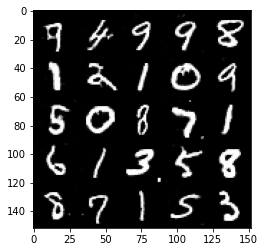

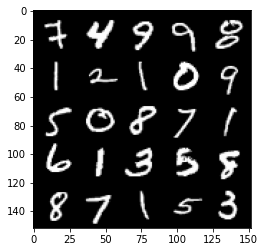

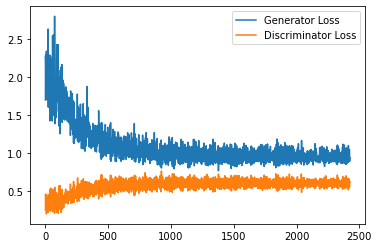

Step 49000: Generator loss: 0.9765030345916748, discriminator loss: 0.6058220294713974


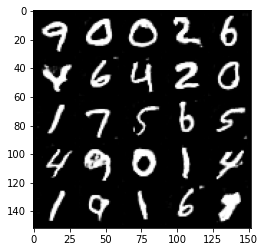

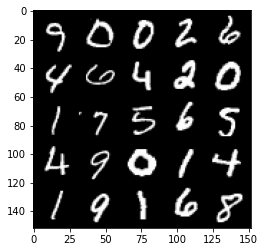

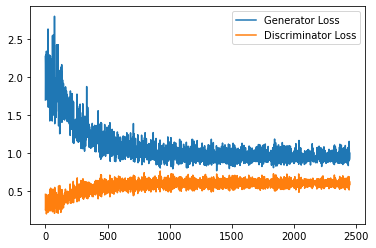

Step 49500: Generator loss: 0.9548133167028428, discriminator loss: 0.6035537994503974


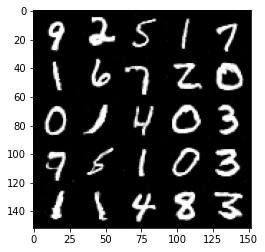

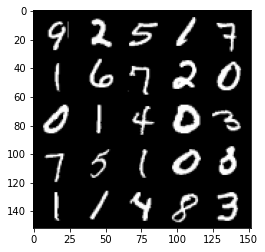

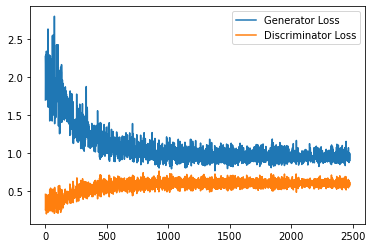

Step 50000: Generator loss: 0.9520430639982224, discriminator loss: 0.606502906024456


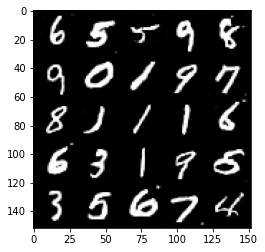

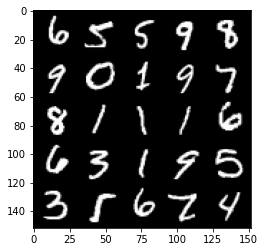

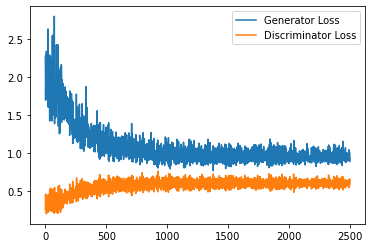

Step 50500: Generator loss: 0.9573451374769211, discriminator loss: 0.6042043011188507


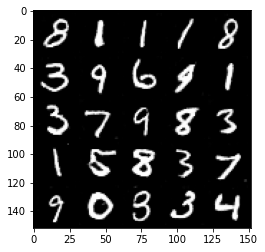

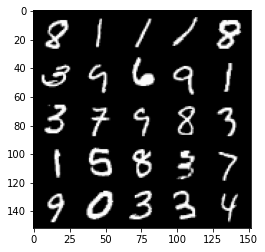

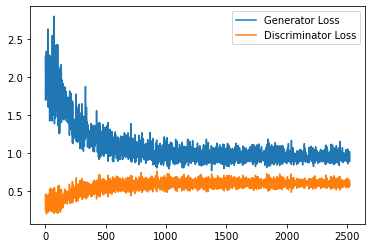

Step 51000: Generator loss: 0.9536158137321472, discriminator loss: 0.6028280012607574


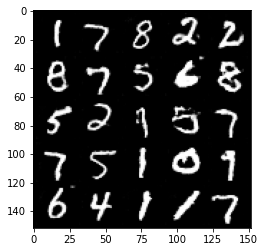

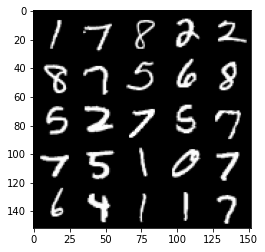

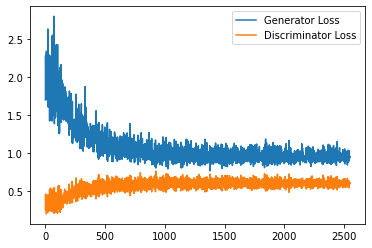

Step 51500: Generator loss: 0.9731650961637497, discriminator loss: 0.6060393044352531


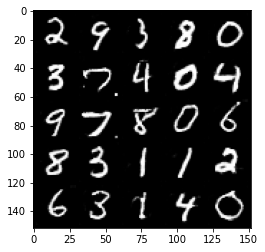

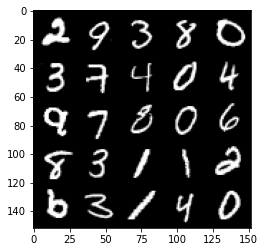

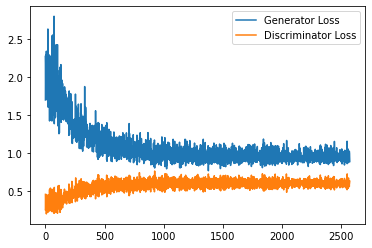

Step 52000: Generator loss: 0.9604923051595687, discriminator loss: 0.6065915994644165


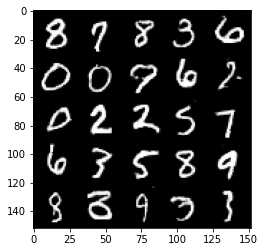

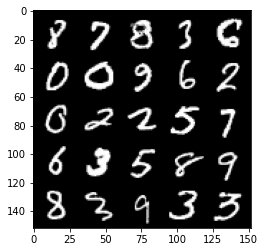

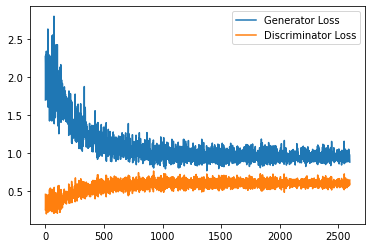

Step 52500: Generator loss: 0.9558741176128387, discriminator loss: 0.60611727643013


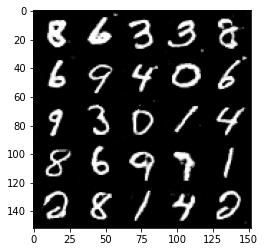

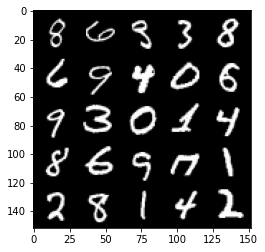

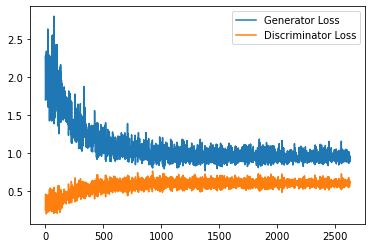

Step 53000: Generator loss: 0.9531665256023407, discriminator loss: 0.6070684062242508


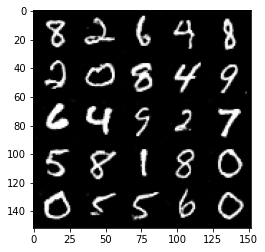

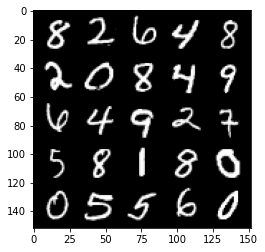

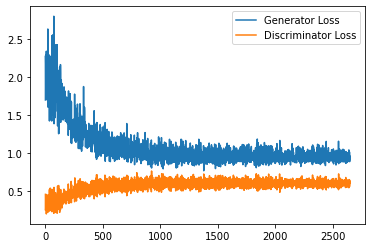

Step 53500: Generator loss: 0.9648815848827362, discriminator loss: 0.6080995806455612


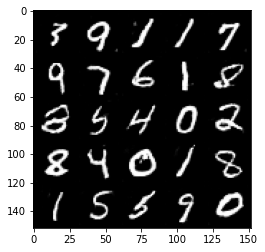

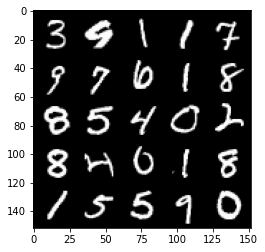

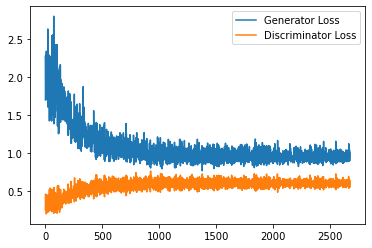

Step 54000: Generator loss: 0.9522274222373962, discriminator loss: 0.610394147515297


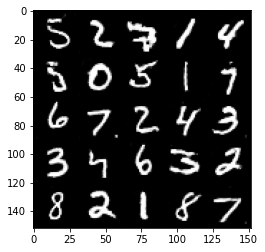

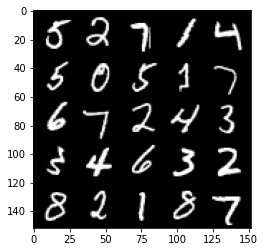

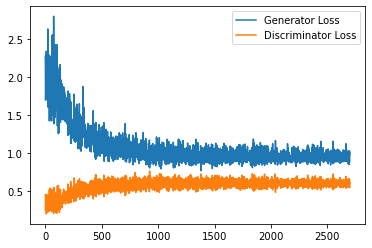

Step 54500: Generator loss: 0.9497916821241379, discriminator loss: 0.6094973095059395


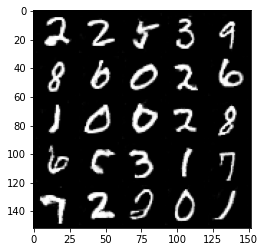

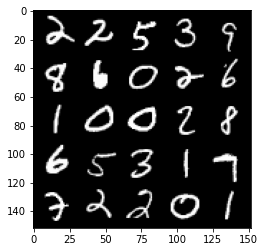

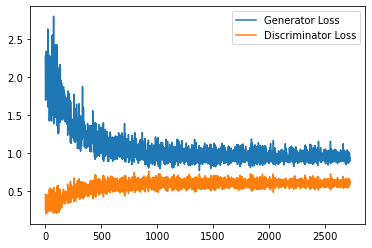

Step 55000: Generator loss: 0.9674976831674575, discriminator loss: 0.6068141846060753


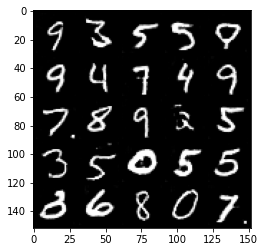

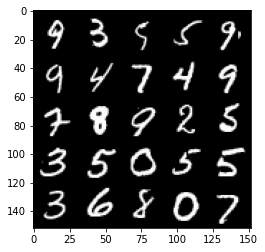

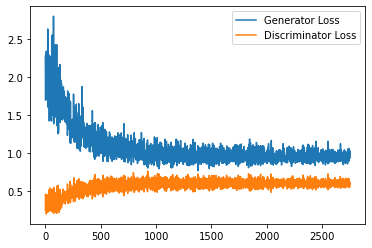

Step 55500: Generator loss: 0.9532072838544846, discriminator loss: 0.6120111305713654


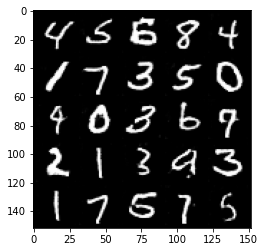

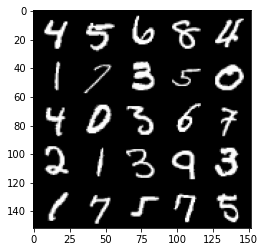

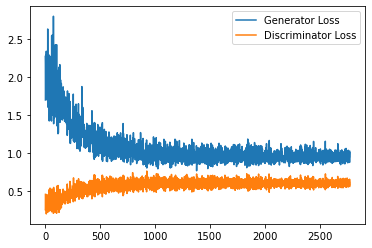

Step 56000: Generator loss: 0.9636562814712525, discriminator loss: 0.6077580046057701


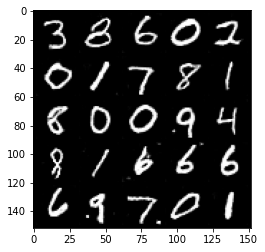

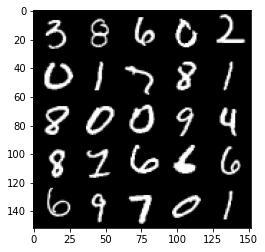

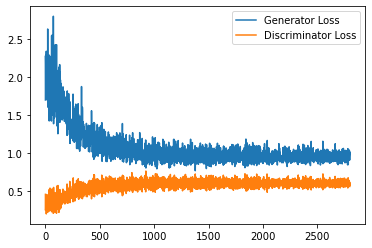

Step 56500: Generator loss: 0.9592041568756103, discriminator loss: 0.6122283627390861


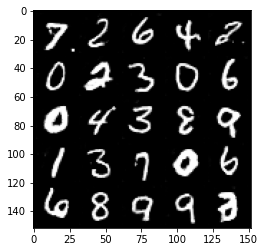

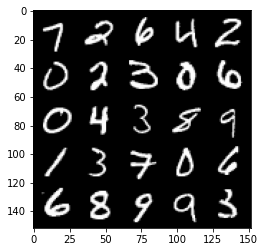

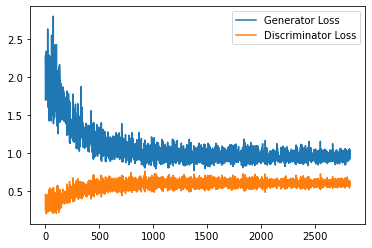

Step 57000: Generator loss: 0.9505888862609864, discriminator loss: 0.6134968628883362


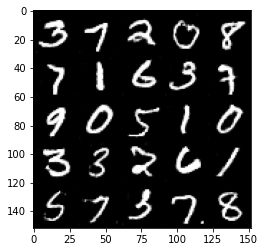

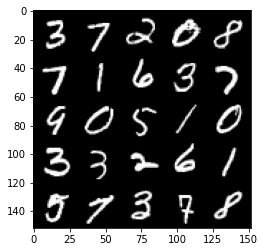

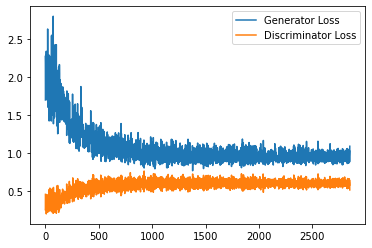

Step 57500: Generator loss: 0.9653442515134811, discriminator loss: 0.6109628404378891


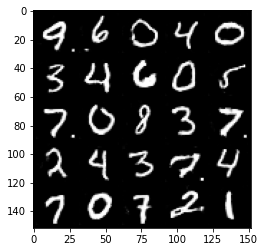

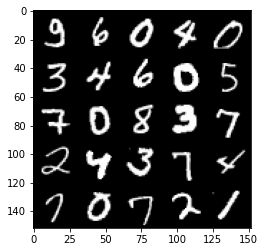

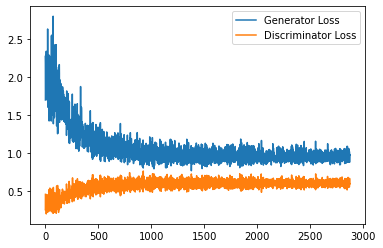

Step 58000: Generator loss: 0.9492986917495727, discriminator loss: 0.6095855994224548


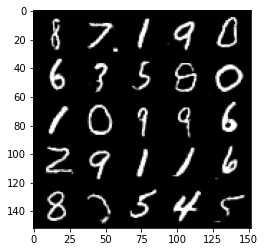

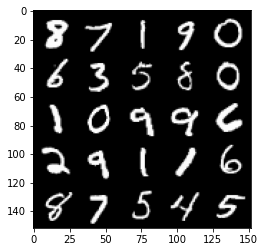

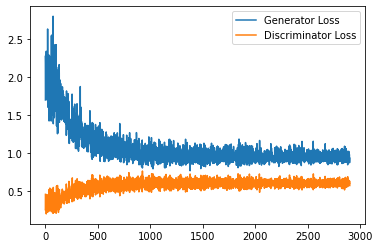

Step 58500: Generator loss: 0.9471742023229599, discriminator loss: 0.609164747774601


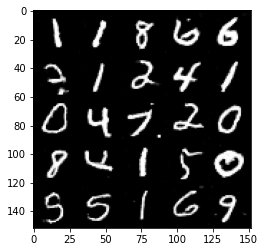

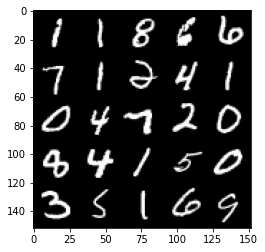

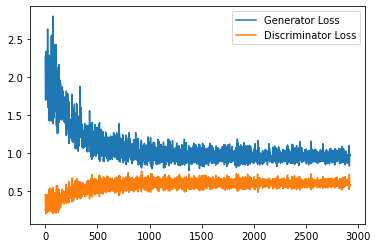

Step 59000: Generator loss: 0.957925069451332, discriminator loss: 0.6135217339992524


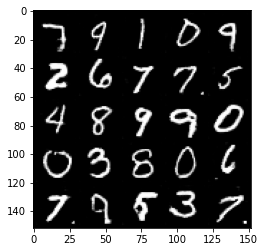

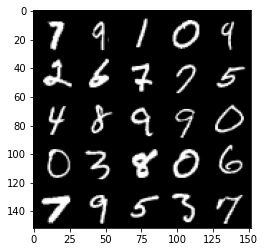

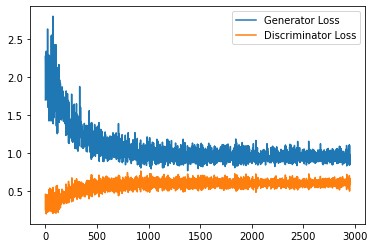

Step 59500: Generator loss: 0.9490349411964416, discriminator loss: 0.6085815713405609


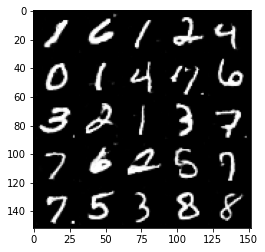

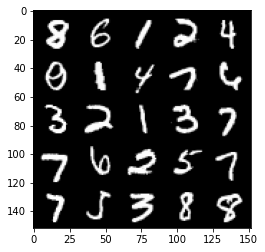

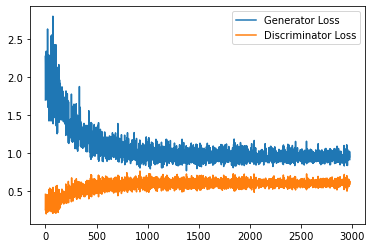

Step 60000: Generator loss: 0.9366388741731644, discriminator loss: 0.6098700827360153


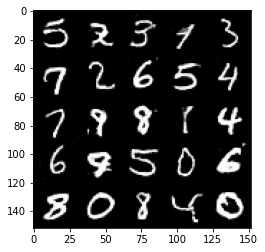

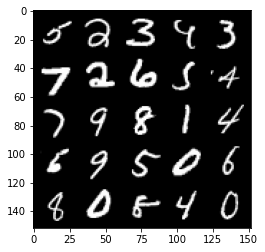

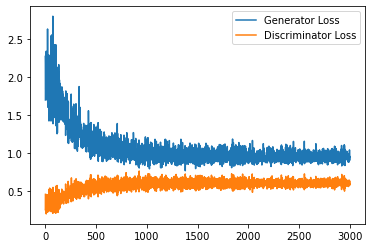

Step 60500: Generator loss: 0.9499627619981765, discriminator loss: 0.6166081112623215


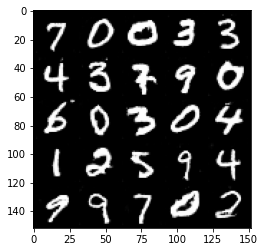

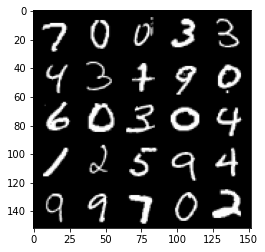

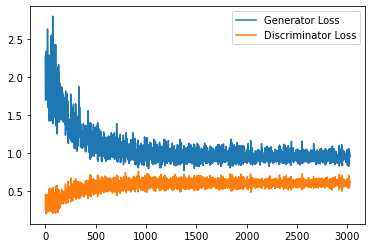

Step 61000: Generator loss: 0.9513827525377273, discriminator loss: 0.6146022849082947


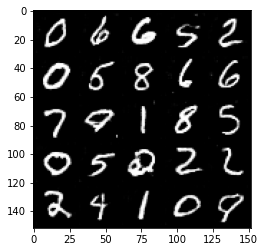

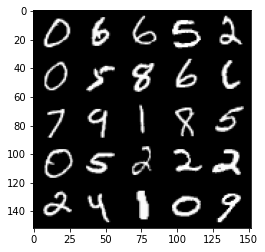

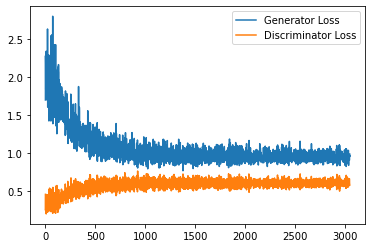

Step 61500: Generator loss: 0.9549894902706146, discriminator loss: 0.6087289729118347


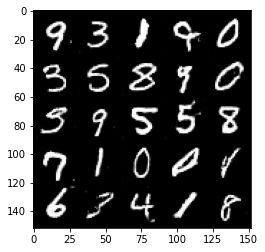

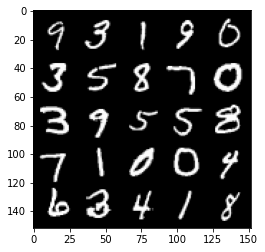

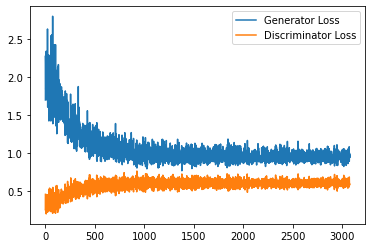

Step 62000: Generator loss: 0.9373743135929108, discriminator loss: 0.6145357996225357


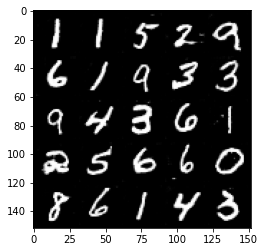

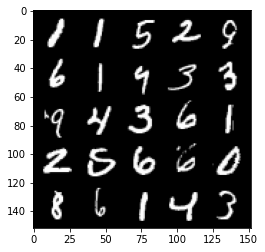

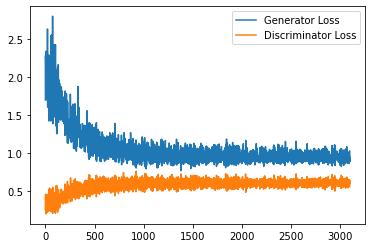

Step 62500: Generator loss: 0.9405522137880326, discriminator loss: 0.614983896970749


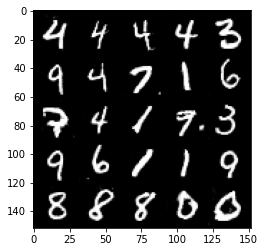

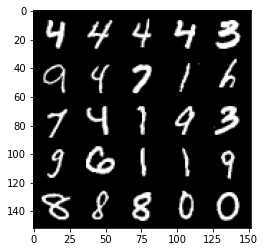

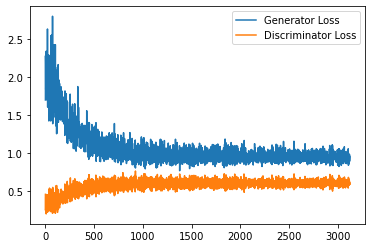

Step 63000: Generator loss: 0.9511623067855834, discriminator loss: 0.6125968880057335


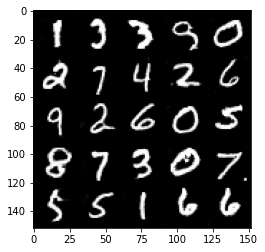

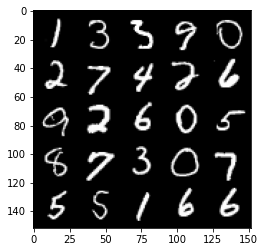

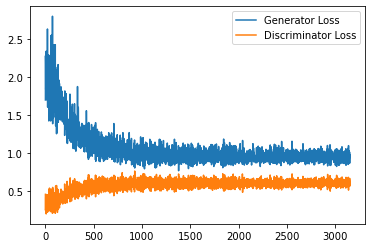

Step 63500: Generator loss: 0.9590538388490677, discriminator loss: 0.6098082168102265


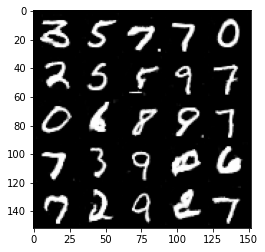

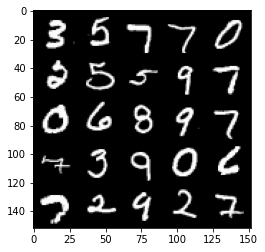

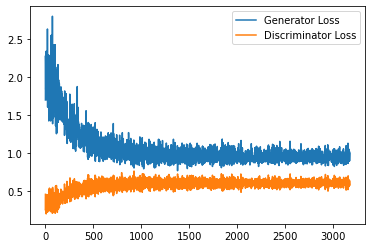

Step 64000: Generator loss: 0.9441844094991684, discriminator loss: 0.6157677376270294


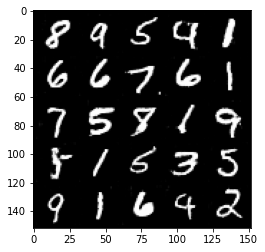

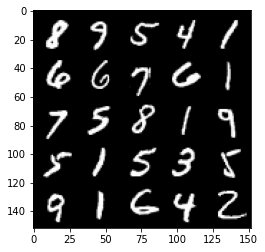

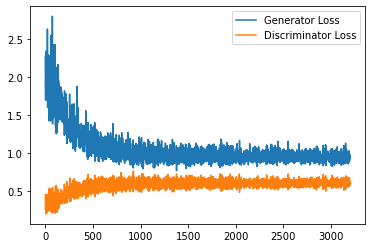

Step 64500: Generator loss: 0.9554116215705871, discriminator loss: 0.6160577219724656


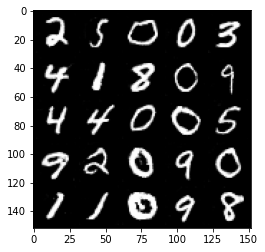

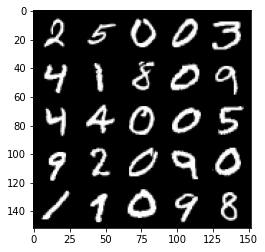

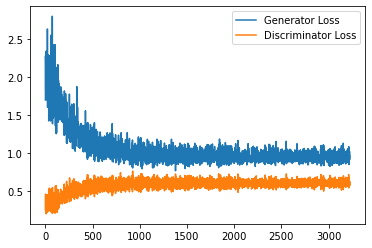

Step 65000: Generator loss: 0.9566867508888245, discriminator loss: 0.6153771344423294


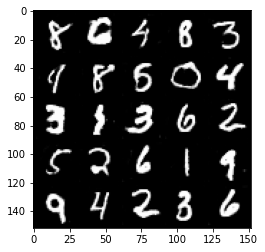

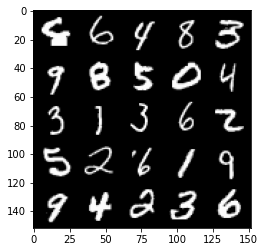

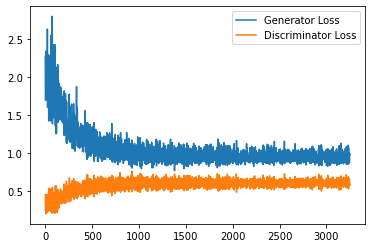

Step 65500: Generator loss: 0.9513459794521332, discriminator loss: 0.6161519339084626


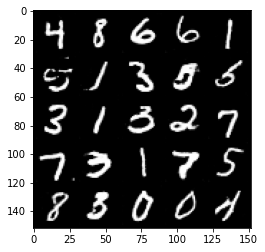

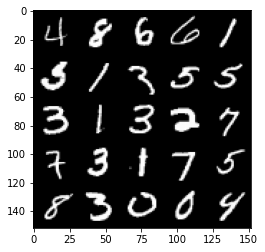

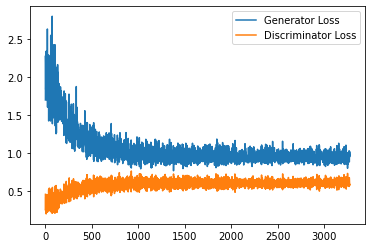

Step 66000: Generator loss: 0.9516370468139649, discriminator loss: 0.6158930074572563


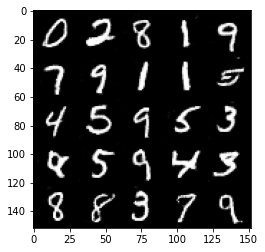

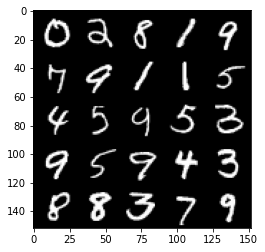

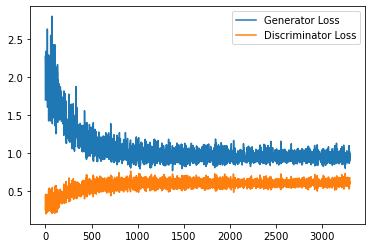

Step 66500: Generator loss: 0.9568047505617142, discriminator loss: 0.6096622102260589


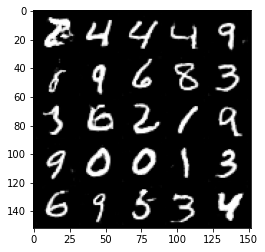

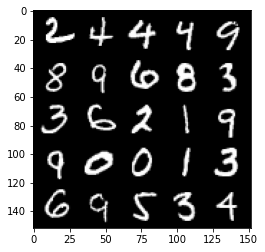

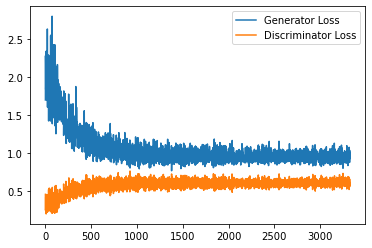

Step 67000: Generator loss: 0.9411526625156402, discriminator loss: 0.6147140788435936


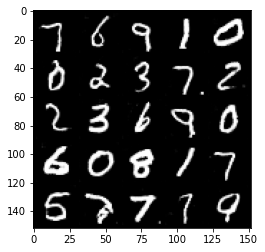

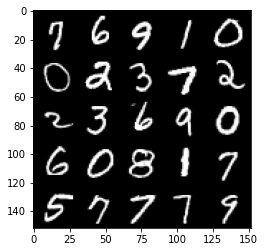

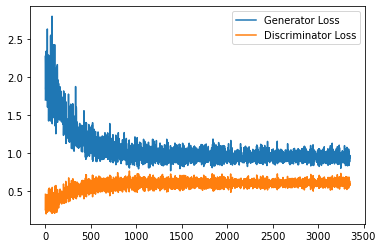

Step 67500: Generator loss: 0.9508066271543503, discriminator loss: 0.6151865642666817


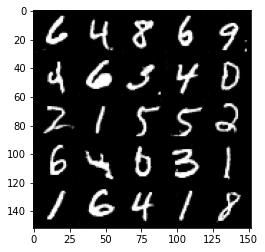

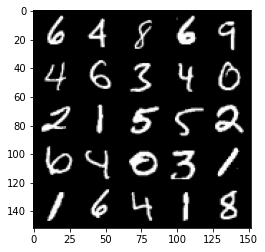

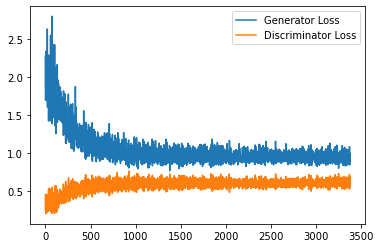

Step 68000: Generator loss: 0.9436953830718994, discriminator loss: 0.6164296135306359


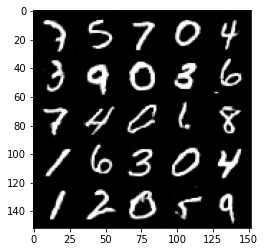

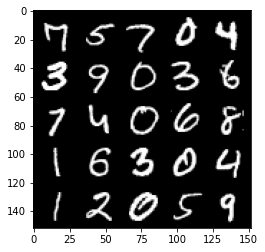

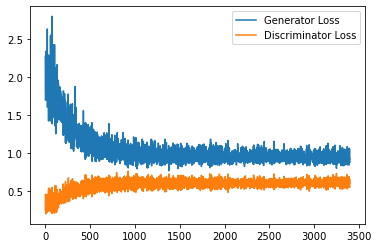

Step 68500: Generator loss: 0.9510676343441009, discriminator loss: 0.6145243347883225


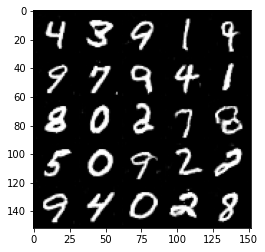

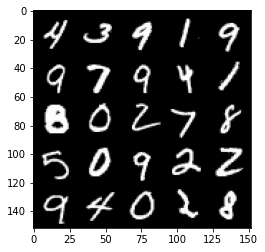

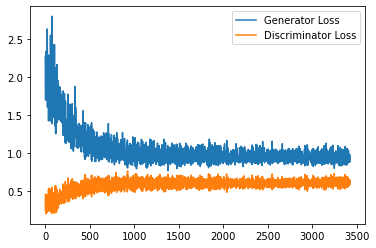

Step 69000: Generator loss: 0.9582055435180664, discriminator loss: 0.6116687608361244


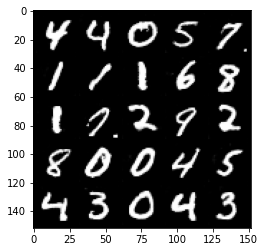

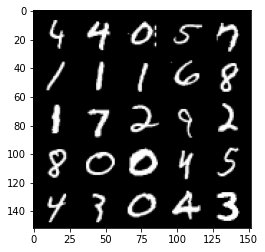

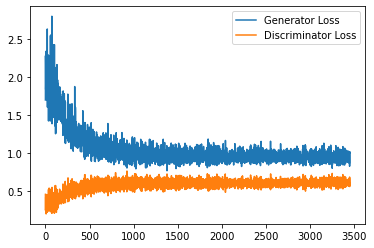

Step 69500: Generator loss: 0.9597911127805709, discriminator loss: 0.6140612041950226


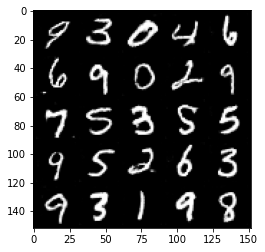

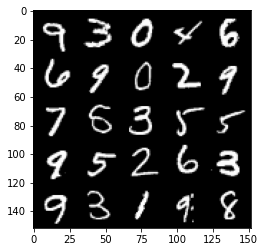

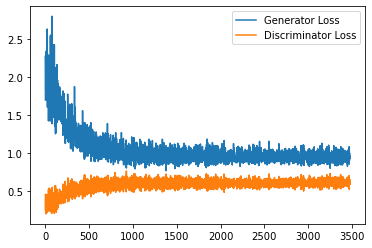

Step 70000: Generator loss: 0.9637223157882691, discriminator loss: 0.614050117790699


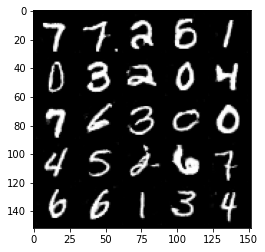

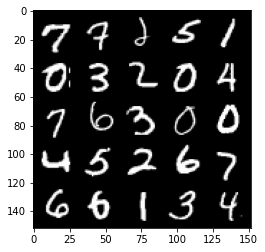

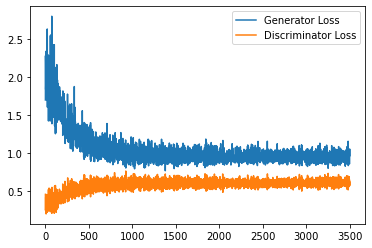

Step 70500: Generator loss: 0.958472798705101, discriminator loss: 0.613749236702919


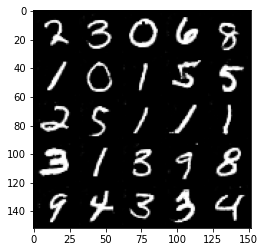

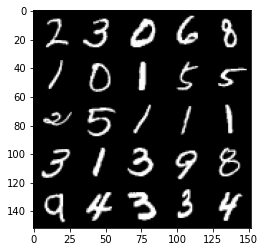

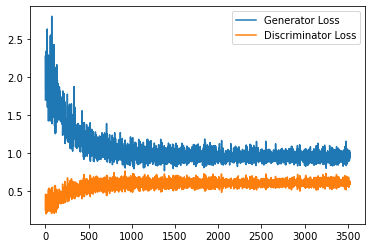

Step 71000: Generator loss: 0.9418349771499633, discriminator loss: 0.614667973279953


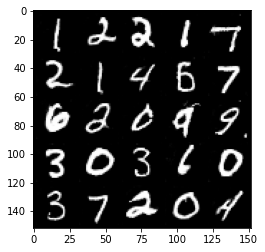

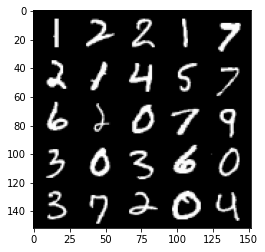

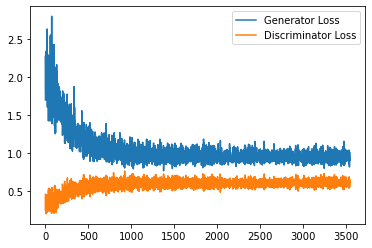

Step 71500: Generator loss: 0.9343899793624878, discriminator loss: 0.611055410683155


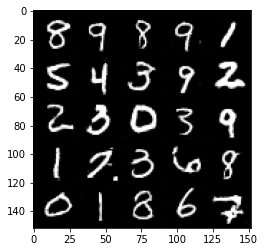

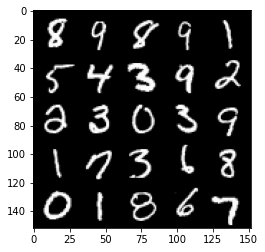

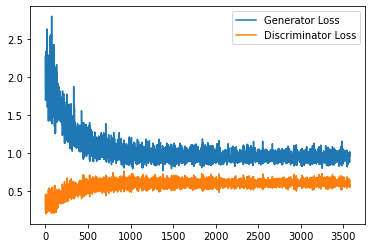

Step 72000: Generator loss: 0.9500173773765564, discriminator loss: 0.6169441495537757


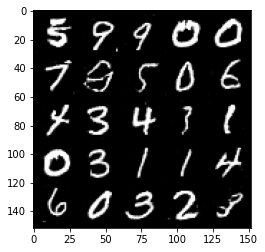

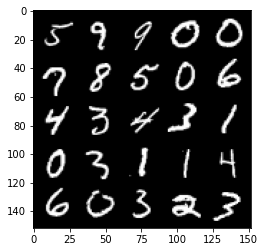

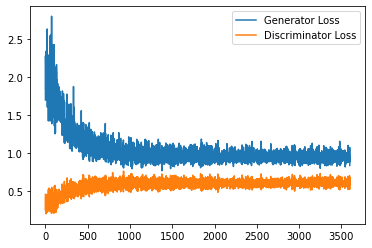

Step 72500: Generator loss: 0.940309446811676, discriminator loss: 0.616064813554287


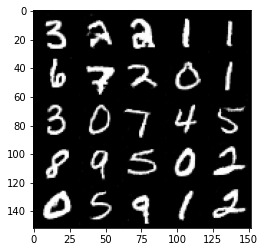

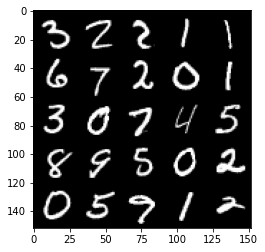

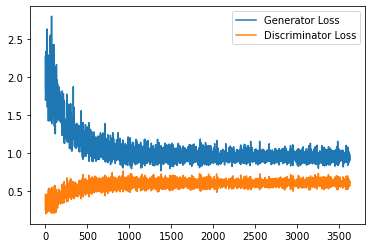

Step 73000: Generator loss: 0.9548595439195633, discriminator loss: 0.6131174910068512


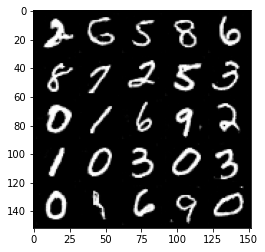

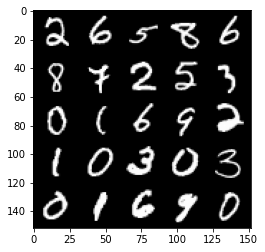

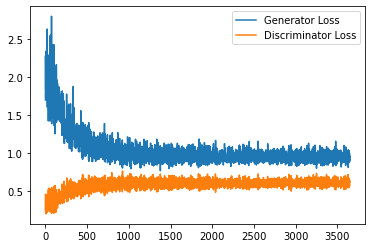

Step 73500: Generator loss: 0.9539790141582489, discriminator loss: 0.6171090608239174


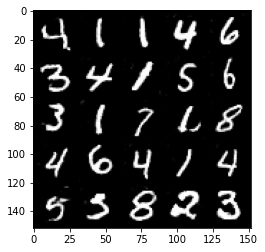

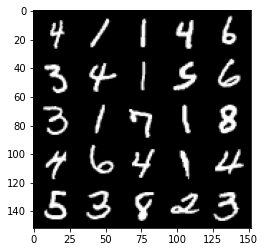

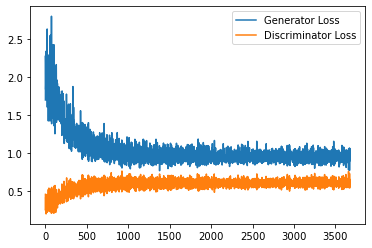

Step 74000: Generator loss: 0.9496420347690582, discriminator loss: 0.6142574599981308


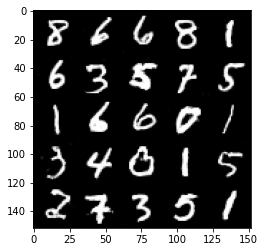

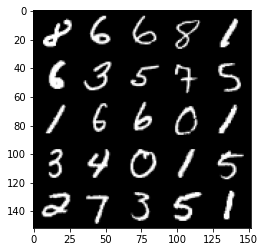

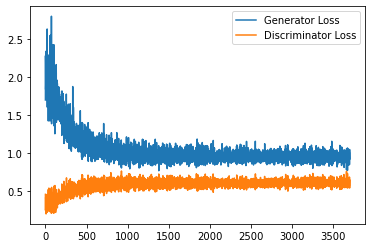

Step 74500: Generator loss: 0.9385979026556015, discriminator loss: 0.6173168352842331


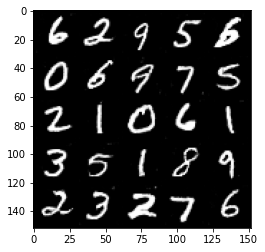

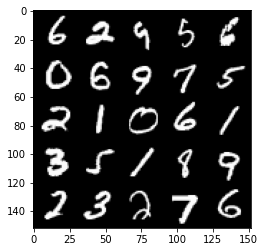

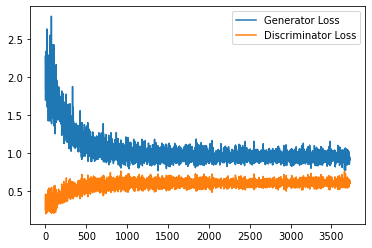

Step 75000: Generator loss: 0.9472969734668731, discriminator loss: 0.6103384488224983


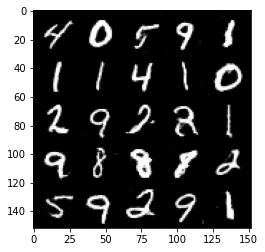

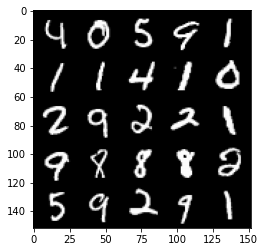

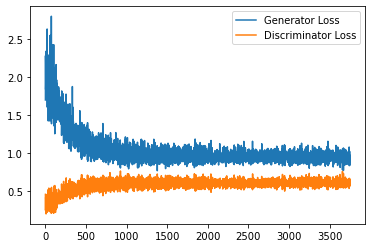

Step 75500: Generator loss: 0.9440958951711654, discriminator loss: 0.6129508888721467


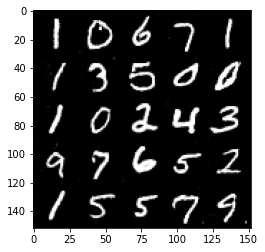

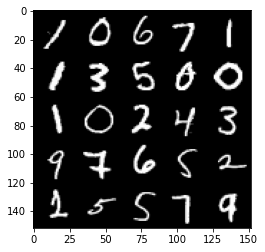

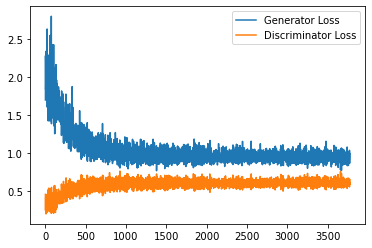

Step 76000: Generator loss: 0.9441067565679551, discriminator loss: 0.6190731746554374


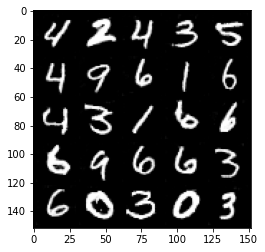

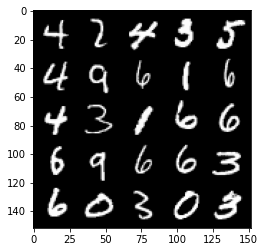

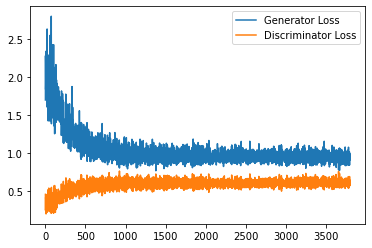

Step 76500: Generator loss: 0.9469120991230011, discriminator loss: 0.6174020826816559


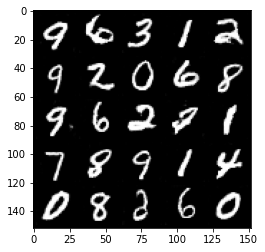

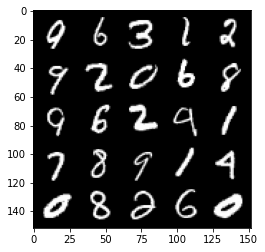

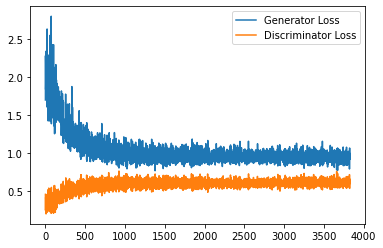

Step 77000: Generator loss: 0.9530308457612992, discriminator loss: 0.6191552124023437


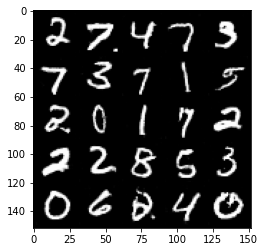

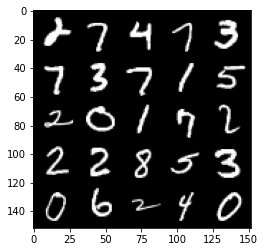

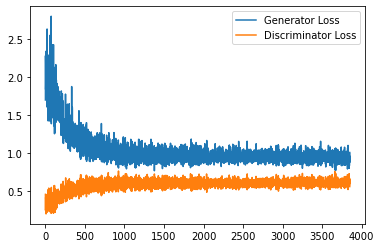

Step 77500: Generator loss: 0.9313194599151612, discriminator loss: 0.6220616518259049


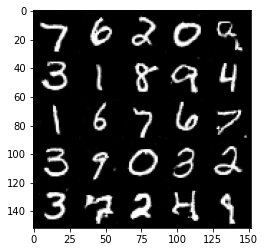

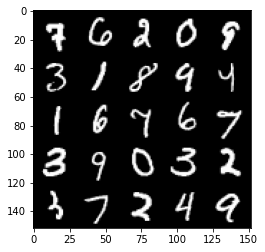

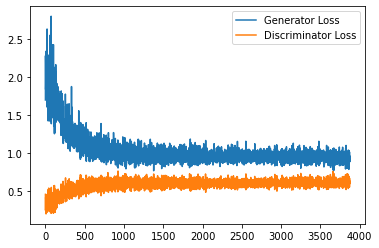

Step 78000: Generator loss: 0.9504457762241364, discriminator loss: 0.6172686541676521


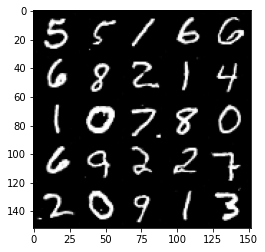

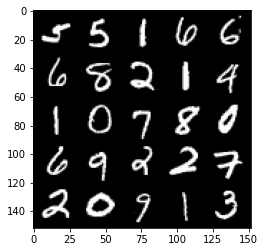

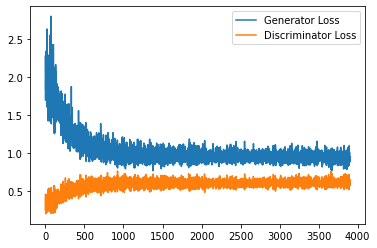

Step 78500: Generator loss: 0.9380162014961243, discriminator loss: 0.6142754555940628


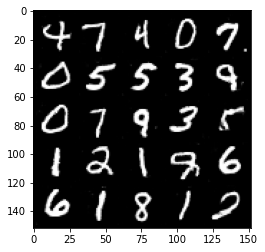

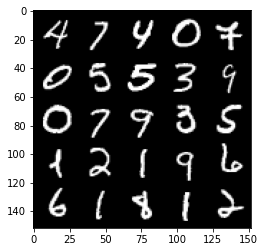

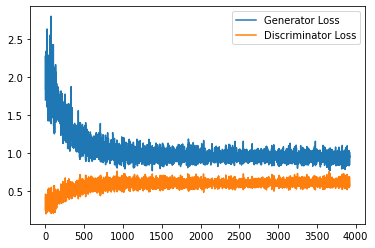

Step 79000: Generator loss: 0.9501823719739914, discriminator loss: 0.6181259055137635


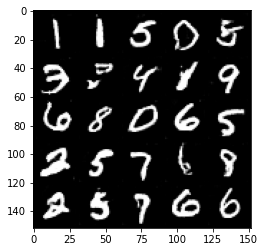

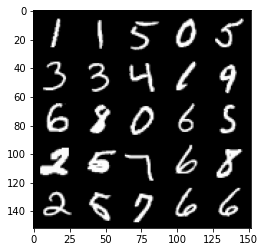

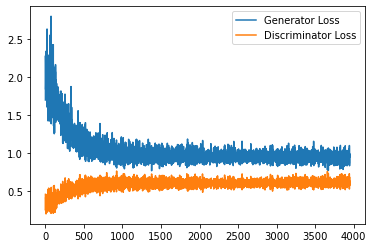

Step 79500: Generator loss: 0.9447436178922654, discriminator loss: 0.6151177880764007


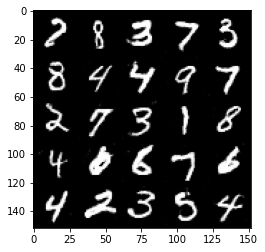

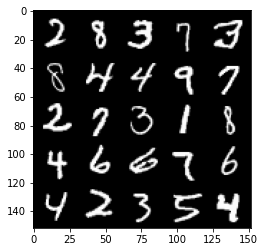

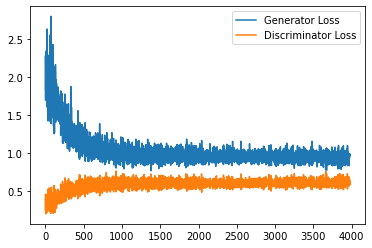

Step 80000: Generator loss: 0.9537860980033874, discriminator loss: 0.6132658423185349


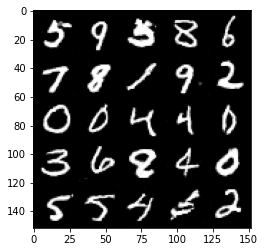

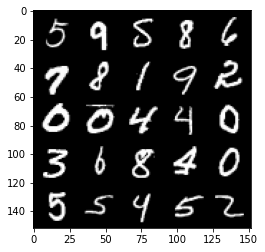

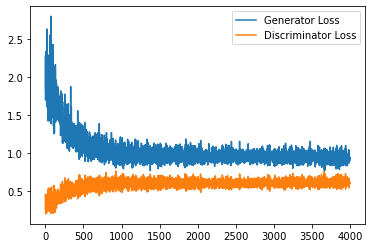

Step 80500: Generator loss: 0.9472645576000214, discriminator loss: 0.6151248664259911


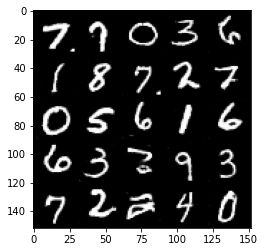

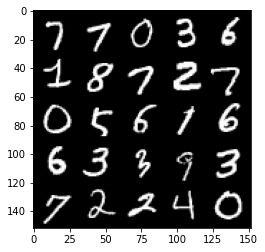

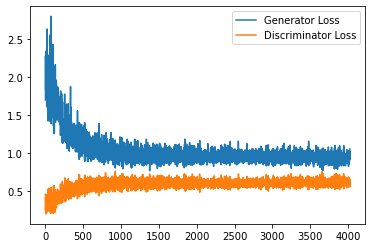

Step 81000: Generator loss: 0.9519407193660736, discriminator loss: 0.6167349129319191


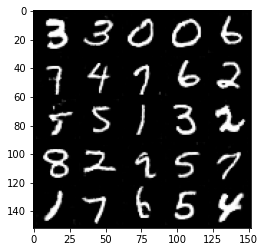

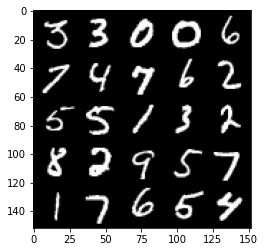

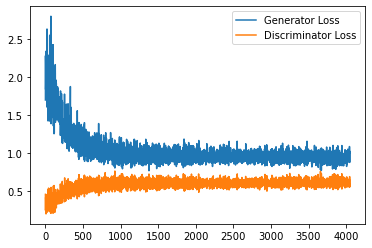

Step 81500: Generator loss: 0.9450431731939316, discriminator loss: 0.6204358632564545


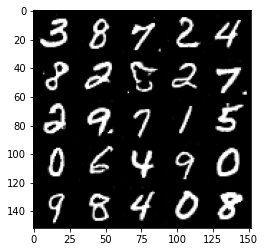

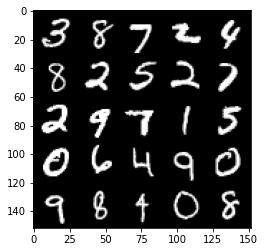

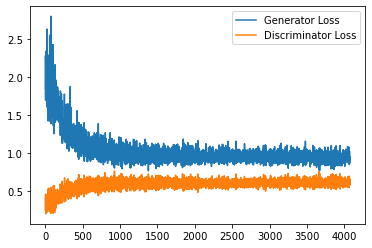

Step 82000: Generator loss: 0.9395538984537125, discriminator loss: 0.6186096349358559


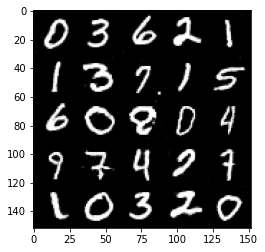

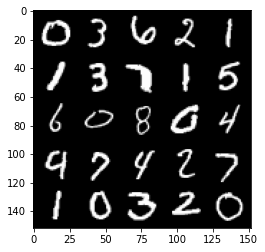

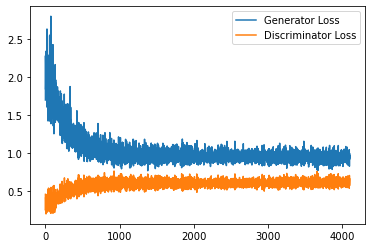

Step 82500: Generator loss: 0.9510257394313812, discriminator loss: 0.6155147932171822


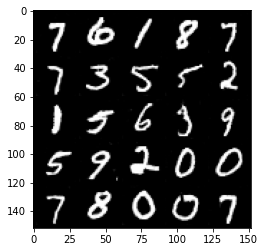

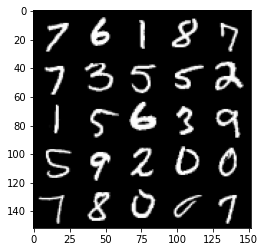

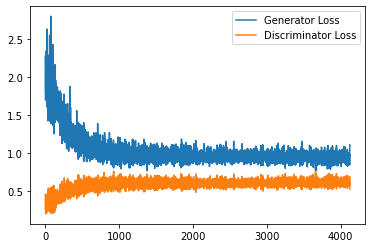

Step 83000: Generator loss: 0.9414097330570221, discriminator loss: 0.6183287268280983


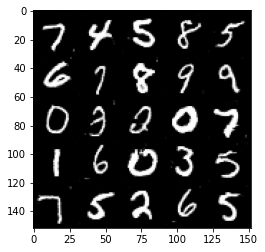

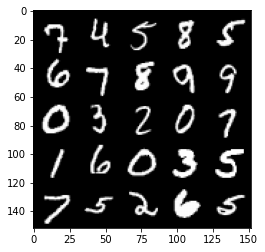

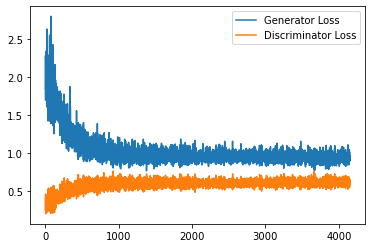

Step 83500: Generator loss: 0.9441112415790558, discriminator loss: 0.6186458921432495


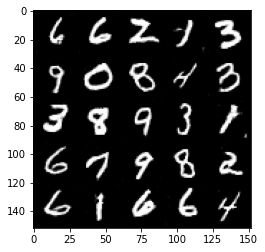

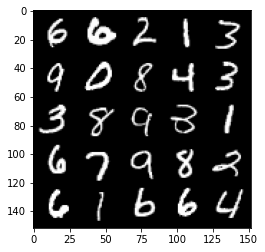

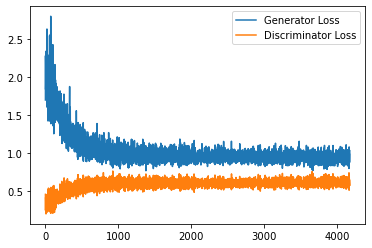

Step 84000: Generator loss: 0.9520717545747757, discriminator loss: 0.6174750652313232


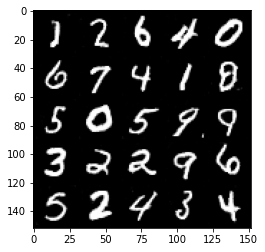

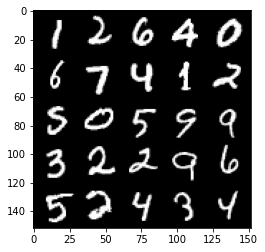

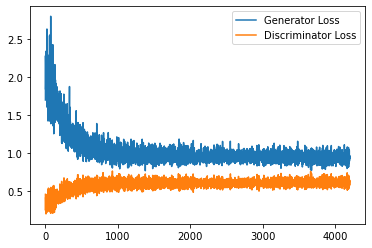

Step 84500: Generator loss: 0.9470034310817719, discriminator loss: 0.6165614967942238


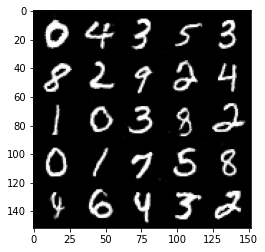

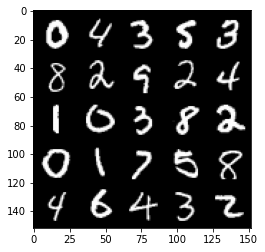

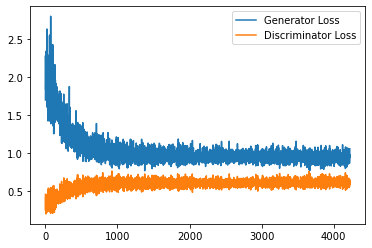

Step 85000: Generator loss: 0.9466891226768493, discriminator loss: 0.6209853976368904


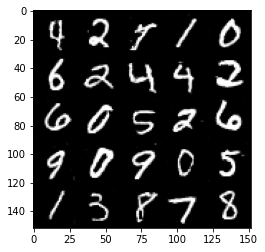

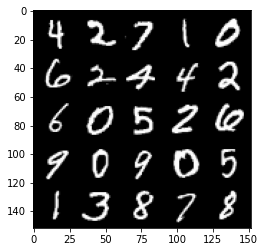

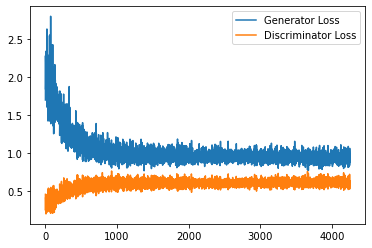

Step 85500: Generator loss: 0.9514175243377686, discriminator loss: 0.6206662816405296


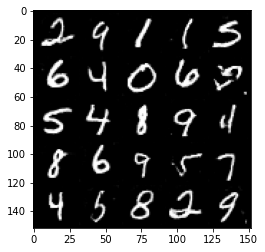

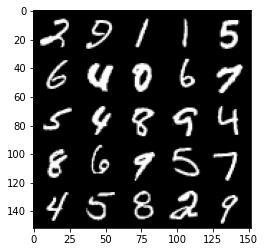

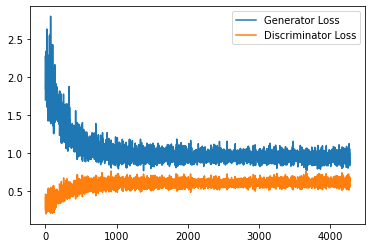

Step 86000: Generator loss: 0.9438875135183334, discriminator loss: 0.6216831228733063


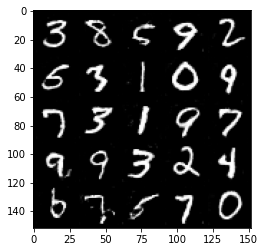

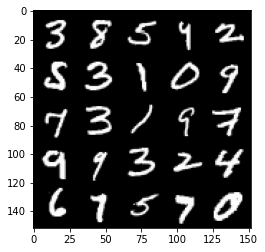

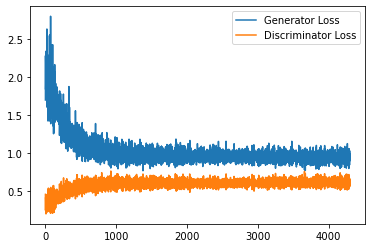

Step 86500: Generator loss: 0.9455879311561585, discriminator loss: 0.6241450853347779


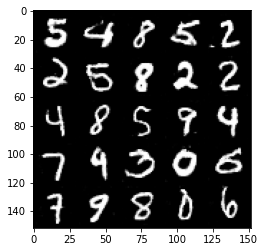

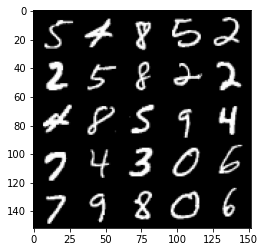

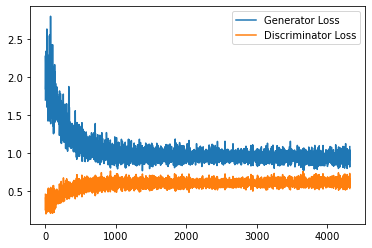

Step 87000: Generator loss: 0.9503686701059342, discriminator loss: 0.6122244057655335


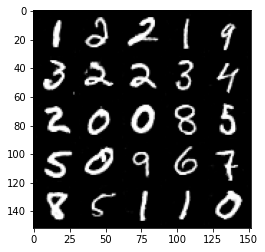

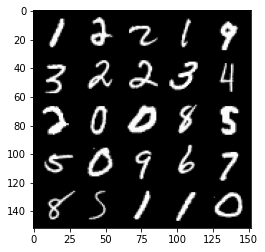

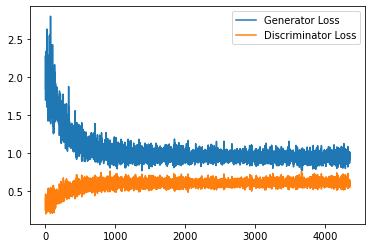

Step 87500: Generator loss: 0.927311526298523, discriminator loss: 0.6232971331477165


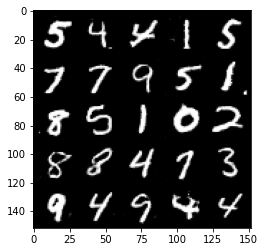

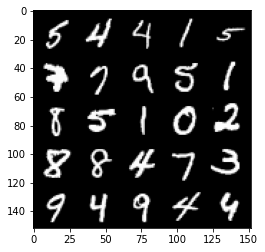

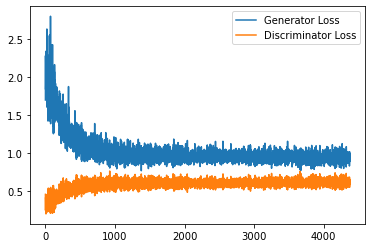

Step 88000: Generator loss: 0.9456188900470733, discriminator loss: 0.6235516902804374


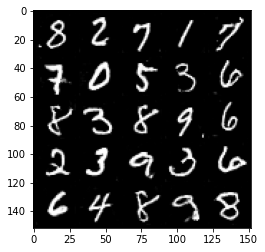

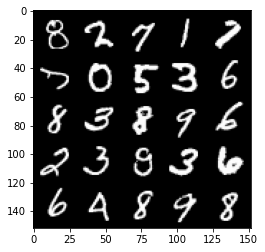

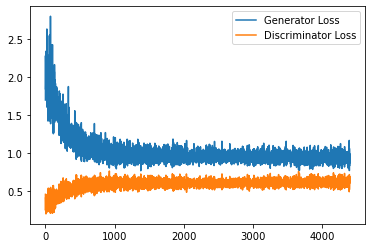

Step 88500: Generator loss: 0.9362099162340164, discriminator loss: 0.6252909609079361


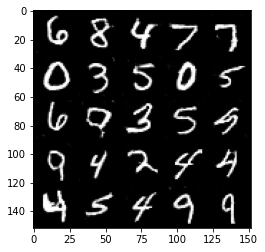

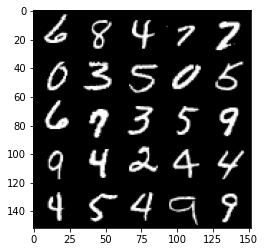

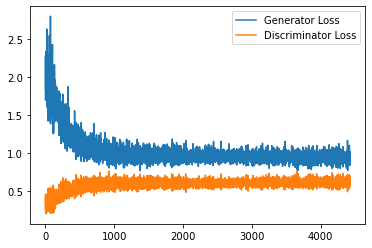

Step 89000: Generator loss: 0.9458498709201812, discriminator loss: 0.6160864463448524


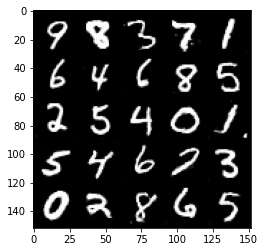

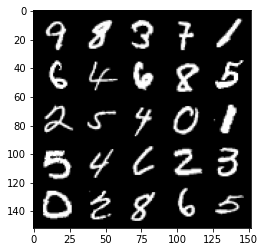

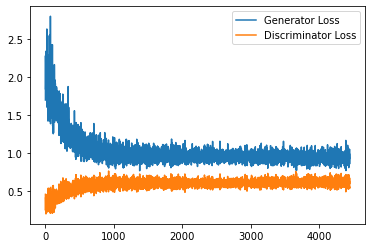

Step 89500: Generator loss: 0.9442524009943009, discriminator loss: 0.620225756585598


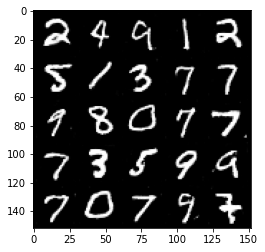

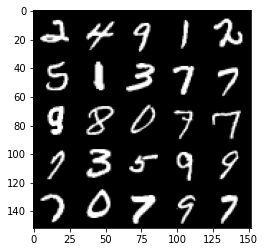

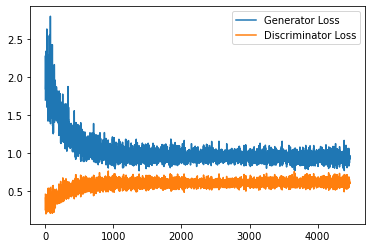

Step 90000: Generator loss: 0.9506988444328308, discriminator loss: 0.6231249453425407


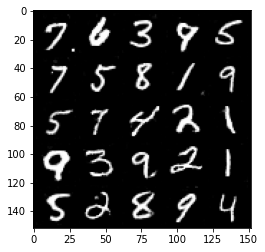

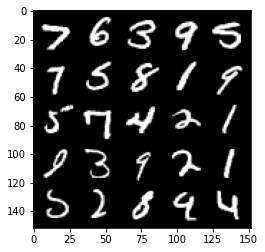

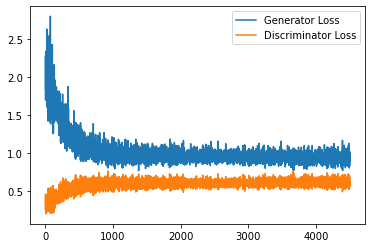

Step 90500: Generator loss: 0.9461280331611633, discriminator loss: 0.619139103770256


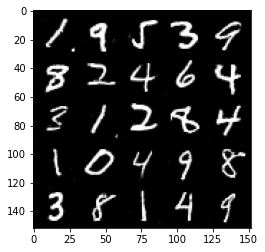

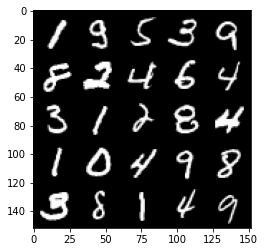

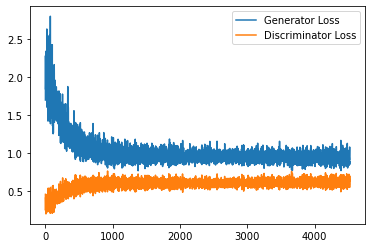

Step 91000: Generator loss: 0.9190636239051819, discriminator loss: 0.6238439553976058


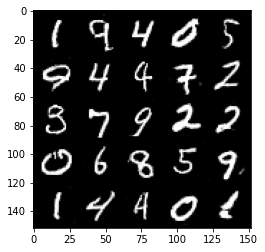

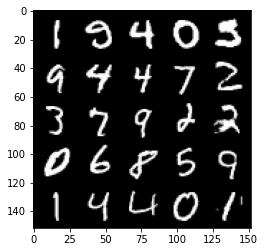

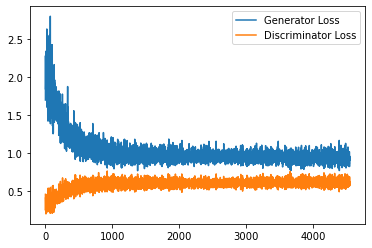

Step 91500: Generator loss: 0.9449215277433395, discriminator loss: 0.61964087164402


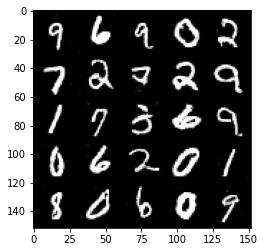

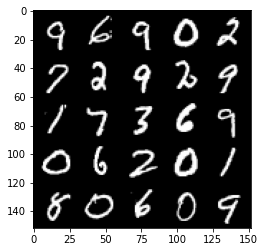

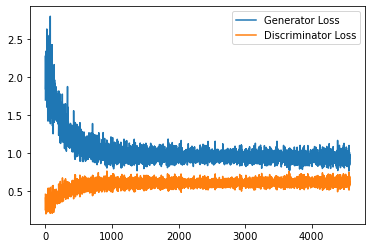

Step 92000: Generator loss: 0.9428026987314224, discriminator loss: 0.6212318738102913


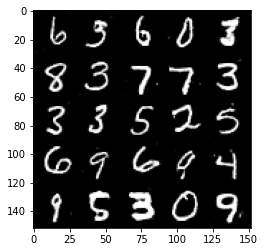

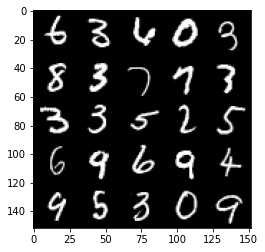

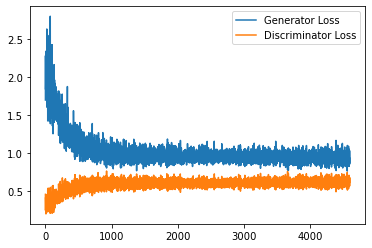

Step 92500: Generator loss: 0.9326422604322433, discriminator loss: 0.6205005526542664


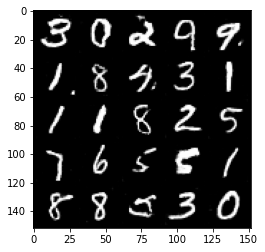

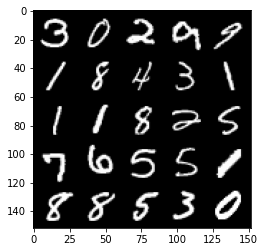

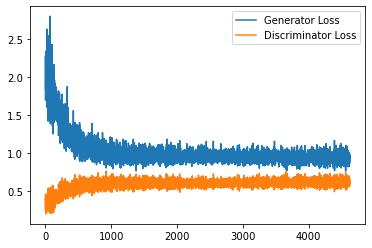

Step 93000: Generator loss: 0.947971024632454, discriminator loss: 0.6226361409425736


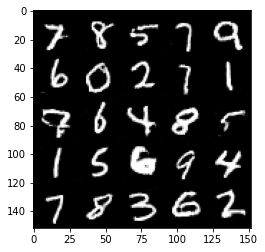

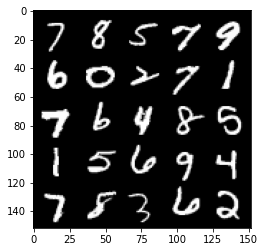

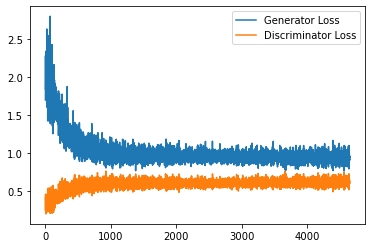

Step 93500: Generator loss: 0.939916780948639, discriminator loss: 0.6172569737434387


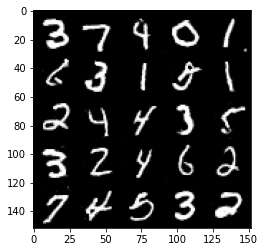

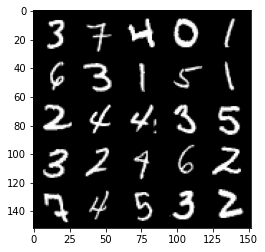

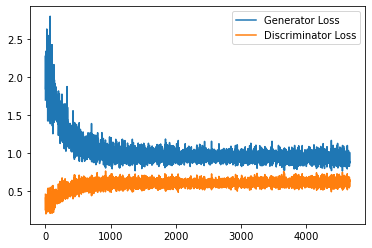

In [35]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()